### Setup

In [ ]:
# %cd ../libs/image_matching_models/
# !git submodule init
# !git submodule update --init /content/image-matching-models/matching/third_party/LightGlue
# !git submodule update --init /content/image-matching-models/matching/third_party/gim
# !git submodule update --init /content/image-matching-models/matching/third_party/accelerated_features
# !pip install --progress-bar off --quiet -r requirements.txt
# !pip install --progress-bar off --quiet -e .
# !pip install timeout-decorator


In [1]:
%%capture
%cd /home/honor/my_project/libs/image_matching_models
# from matching import get_matcher, 'gim-lg', 'xfeat', 'disk-lg'
import os
import sys
from matching import get_matcher, available_models
from matching.viz import *
from pathlib import Path
import torch
import warnings
import numpy as np
from scipy.spatial.transform import Rotation as R
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import open3d as o3d
import timeout_decorator

warnings.filterwarnings("ignore")

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Using device: {device}')

ransac_kwargs = {'ransac_reproj_thresh':3,
                  'ransac_conf':0.95,
                  'ransac_iters':2000} 

Using device: cuda


### Load images, depth maps

In [3]:
%cd ../..

/home/honor/my_project


In [4]:
chosen_matchers = ['gim-lg', 'xfeat', 'disk-lg']
image_size = 512
step = 30
image_step = 1 #because only storing already downsampled images

In [5]:
!pwd

/home/honor/my_project


In [6]:
video_name = 'cecum_t2_b'

# Directory containing frame images
frames_dir = Path(f'/home/honor/my_project/data/C3VD/{video_name}')
print ("Frames directory:", frames_dir)
image_paths = sorted(frames_dir.glob('*_color.png'), key=lambda x: int(x.stem.split('_')[0]))
depth_maps = sorted(frames_dir.glob('*_depth.tiff'), key=lambda x: int(x.stem.split('_')[0]))
print("Number of frames in frame directory:", len(image_paths))
frame_paths_1fps = image_paths[::image_step]
depth_maps_1fps = depth_maps[::image_step]
print("Number of selected frames (frame_paths_1fps):", len(frame_paths_1fps))
print("Number of depth maps:", len(depth_maps_1fps))


Frames directory: /home/honor/my_project/data/C3VD/cecum_t2_b
Number of frames in frame directory: 39
Number of selected frames (frame_paths_1fps): 39
Number of depth maps: 39


In [7]:

## Check image paths
for frame in frame_paths_1fps:
  print(frame.as_posix())

/home/honor/my_project/data/C3VD/cecum_t2_b/0000_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0030_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0060_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0090_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0120_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0150_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0180_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0210_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0240_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0270_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0300_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0330_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0360_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0390_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0420_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0450_color.png
/home/honor/my_project/data/C3VD/cecum_t2_b/0480_color.p

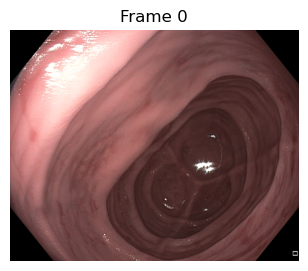

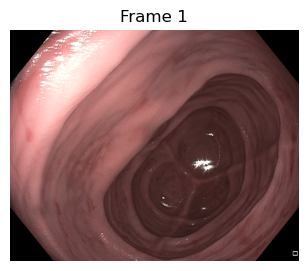

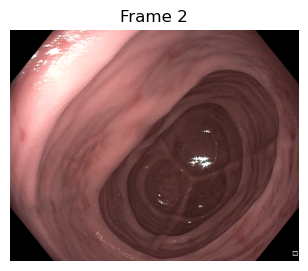

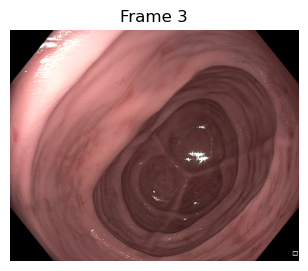

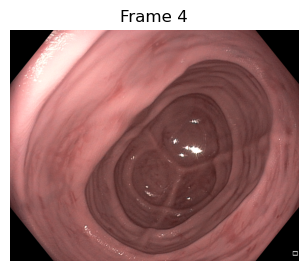

...

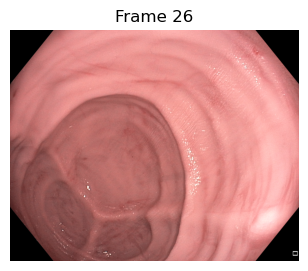

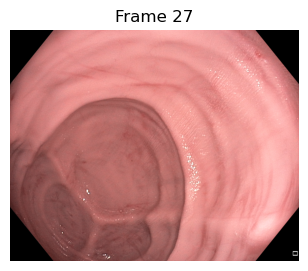

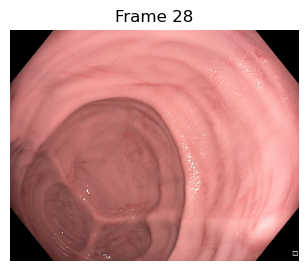

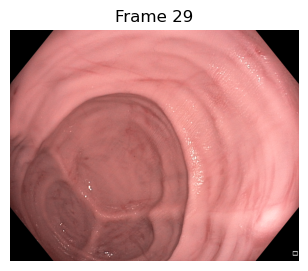

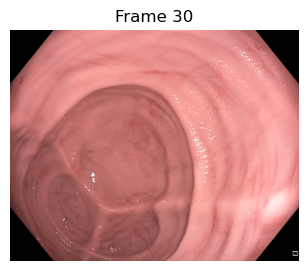

In [8]:
#View the selected images
import matplotlib.pyplot as plt

# Define the desired display size (width, height in inches)
display_size = (4, 3)  # Medium size
view_images = True
# Loop through all images and display them
if view_images:
    for i in range(len(frame_paths_1fps)):
        image = plt.imread(frame_paths_1fps[i]) 

        if image is None:
            print(f"Error: Could not load image {frame_paths[i]}")
            continue

        plt.figure(figsize=display_size)
        plt.imshow(image)
        plt.title(f'Frame {i}')  
        plt.axis('off')  

        # Show the image
        plt.show()
        if i == 30:
            break

### Load poses 

In [9]:
frame_paths = []

def load_poses(pose_file, step=1):
    """Load camera-to-world poses and return them as NumPy arrays."""
    poses = []
    with open(pose_file, 'r') as f:
        lines = f.readlines()
        for i in range(0, len(lines), step):
            # Load values as a flat array
            values = list(map(float, lines[i].strip().split(',')))

            R_cam_to_world = np.array(values[:12]).reshape(3, 4)[:3, :3]
            t_cam_to_world = np.array(values[12:15])

            # Build the full camera-to-world 4x4 matrix
            camera_to_world = np.eye(4)
            camera_to_world[:3, :3] = R_cam_to_world
            camera_to_world[:3, 3] = t_cam_to_world


            # Invert rotation by transposing
            R_world_to_cam = R_cam_to_world.T
            t_world_to_cam = -np.dot(R_world_to_cam, t_cam_to_world)

            # Construct the world-to-camera transformation matrix
            world_to_camera = np.eye(4)
            world_to_camera[:3, :3] = R_world_to_cam
            world_to_camera[:3, 3] = t_world_to_cam


            # Add frame path and world to camera pose matrix into pose array
            frame_name = f"{i:04d}_color.png"
            # frame_name = f"{i}_color_undistorted.png"
            frame_path = os.path.join(f'/workspace/honor/my_project/data/C3VD/{video_name}/', frame_name)
            frame_paths.append(frame_path)
            poses.append({
                'frame_path': frame_path,
                'pose_matrix': world_to_camera
            })
        return poses


def get_relative_pose(T1_w2c, T2_w2c):
    return np.linalg.inv(T1_w2c) @ T2_w2c


In [10]:
gt_abs_poses = load_poses(f'/home/honor/my_project/data/C3VD/{video_name}/pose.txt', step=step)
print(f"Loaded {len(gt_abs_poses)} ground truth absolute poses.")
print(gt_abs_poses[2]['pose_matrix'])
print(np.linalg.inv(gt_abs_poses[2]['pose_matrix']))

Loaded 39 ground truth absolute poses.
[[ 6.50183000e-01  7.21839000e-01 -2.37090000e-01 -9.53984526e+01]
 [-7.14111000e-01  6.87143000e-01  1.33720000e-01  1.34374721e+01]
 [ 2.59439000e-01  8.23661000e-02  9.62241000e-01  8.33400030e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[ 6.50182290e-01 -7.14110290e-01  2.59438693e-01  5.00006000e+01]
 [ 7.21838086e-01  6.87142200e-01  8.23659944e-02  5.27644000e+01]
 [-2.37089909e-01  1.33719969e-01  9.62240561e-01 -1.04608000e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [11]:
# for i in range(3):
#   with np.printoptions(precision=6, suppress=True, linewidth=100):
#     print(gt_abs_poses[i]['pose_matrix'])


In [12]:

gt_relative_poses = []
for i in range(0,len(gt_abs_poses) - 1):
    T_i = gt_abs_poses[i]['pose_matrix'] # world to camera i
    T_next = gt_abs_poses[i + 1]['pose_matrix'] # world to camera i+1
    T_rel = get_relative_pose(T_i, T_next)  # now correctly T_i^-1 @ T_next
    gt_relative_poses.append(T_rel)

In [13]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plot_gt_vs_relative_trajectory(
    gt_abs_poses,          # List of dicts with 'pose_matrix' (W2C)
    gt_rel_poses,          # List of relative poses (4x4)
    title="GT vs Relative Trajectory (W2C)",
    show_axes=True,
    point_size=5,
    line_width=3,
    height=700,
    width=900
):
    """
    Plots absolute GT (W2C) trajectory and reconstructed relative trajectory (also W2C) on one plot.
    """

    def camera_center_from_w2c(w2c):
        R = w2c[:3, :3]
        t = w2c[:3, 3]
        return -R.T @ t

    # --- Absolute GT camera positions ---
    gt_abs_matrices = [p['pose_matrix'] for p in gt_abs_poses]
    gt_abs_positions = np.array([camera_center_from_w2c(pose) for pose in gt_abs_matrices])
    gt_abs_orientations = np.array([pose[:3, :3] for pose in gt_abs_matrices])

    # --- Reconstruct trajectory from relative poses ---
    abs_from_rel = [gt_abs_matrices[0]]
    current_pose = gt_abs_matrices[0].copy()
    for rel in gt_rel_poses:
        current_pose = current_pose @ rel
        abs_from_rel.append(current_pose.copy())




    rel_abs_positions = np.array([camera_center_from_w2c(pose) for pose in abs_from_rel])
    rel_orientations = np.array([pose[:3, :3] for pose in abs_from_rel])

    # --- Plotting ---
    fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'scatter3d'}]])

    # Absolute GT trajectory
    fig.add_trace(
        go.Scatter3d(
            x=gt_abs_positions[:, 0],
            y=gt_abs_positions[:, 1],
            z=gt_abs_positions[:, 2],
            mode='lines+markers',
            marker=dict(size=point_size, color='blue'),
            line=dict(color='blue', width=line_width),
            name='GT Absolute (W2C)'
        )
    )

    # Reconstructed trajectory from relative poses
    fig.add_trace(
        go.Scatter3d(
            x=rel_abs_positions[:, 0],
            y=rel_abs_positions[:, 1],
            z=rel_abs_positions[:, 2],
            mode='lines+markers',
            marker=dict(size=point_size, color='orange'),
            line=dict(color='orange', width=line_width),
            name='Reconstructed from Relative'
        )
    )

    # Optional: Draw axes on some frames from GT abs
    if show_axes:
        indices = [0, len(gt_abs_positions) // 2, len(gt_abs_positions) - 1]
        axis_colors = ['red', 'green', 'blue']
        axis_labels = ['X', 'Y', 'Z']
        arrow_scale = np.max(np.ptp(gt_abs_positions, axis=0)) * 0.05

        for idx in indices:
            pos = gt_abs_positions[idx]
            R = gt_abs_orientations[idx]
            for i in range(3):
                end = pos + R[:, i] * arrow_scale
                fig.add_trace(
                    go.Scatter3d(
                        x=[pos[0], end[0]],
                        y=[pos[1], end[1]],
                        z=[pos[2], end[2]],
                        mode='lines',
                        line=dict(color=axis_colors[i], width=4),
                        name=f"GT Axis {axis_labels[i]}" if idx == indices[0] else None,
                        showlegend=(idx == indices[0])
                    )
                )

    # Layout
    fig.update_layout(
        title=dict(text=title, x=0.5, y=0.95),
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='data',
            camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
        ),
        height=height,
        width=width,
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="center",
            x=0.5
        )
    )

    fig.show()
    return fig


In [14]:
fig = plot_gt_vs_relative_trajectory(
    gt_abs_poses=gt_abs_poses,
    gt_rel_poses=gt_relative_poses[0:],  
    title="GT Absolute vs Reconstructed Relative Trajectory"
)


In [15]:
# for i in range(3):
#   with np.printoptions(precision=6, suppress=True, linewidth=100):
#     print(gt_relative_poses[i])

### Undistort images and depth map

In [16]:
def undistort_images(depth_image_path, frame_path=None, display=False):
    # Read depth image
    depth_image = cv2.imread(depth_image_path, cv2.IMREAD_ANYDEPTH)
    
    # Convert depth image to float and scale
    depth_image = (depth_image.astype(np.float32)/(2**16-1))*100
    
    # Print depth image info
    
    print(f"Depth image shape: {depth_image.shape}, data type: {depth_image.dtype}")
    print(f"Depth value range: {np.min(depth_image)} - {np.max(depth_image)}")
    
    # Get depth image size
    height, width = depth_image.shape
    
    # Set camera intrinsic matrix
    K = np.array([[fx, 0, cx], [0, fy, cy], [0, 0, 1]])
    
    # Set distortion coefficients - for fisheye camera model
    D = np.array([k1, k2, k3, k4])
    
    # Store original depth image for visualization
    original_depth = depth_image.copy()
    
    # Read original frame if path is provided
    original_frame = None
    undistorted_frame = None
    if frame_path and os.path.exists(frame_path):
        original_frame = cv2.imread(frame_path)
        if original_frame is None:
            print(f"Warning: Could not read frame from {frame_path}")
    
    try:
        # Undistort using fisheye camera model
        map1, map2 = cv2.fisheye.initUndistortRectifyMap(
            K, D, np.eye(3), K, (width, height), cv2.CV_32FC1
        )
        
        # Undistort depth image
        undistorted_depth = cv2.remap(depth_image, map1, map2, cv2.INTER_LINEAR)
        
        # Undistort frame if available
        if original_frame is not None:
            undistorted_frame = cv2.remap(original_frame, map1, map2, cv2.INTER_LINEAR)
    
    except Exception as e:
        print(f"Undistortion failed, using original images: {e}")
        undistorted_depth = depth_image.copy()
        if original_frame is not None:
            undistorted_frame = original_frame.copy()
    
    # Create a mask of valid depth pixels
    valid_mask = undistorted_depth > 0
    valid_depth_count = np.sum(valid_mask)
    print(f"Number of valid depth pixels: {valid_depth_count}")
    
    if valid_depth_count == 0:
        print("Warning: No valid depth values found")
        if original_frame is not None:
            return np.array([[0, 0, 0]]), None
        return np.array([[0, 0, 0]])
    
    # # -----------------------------
    # # Visualization
    # # -----------------------------
    if display:
        if original_frame is not None:
            # Plot both depth and frame
            plt.figure(figsize=(15, 10))
            
            # Top row - Depth images
            plt.subplot(2, 3, 1)
            plt.title("Original Depth Image")
            plt.imshow(original_depth, cmap='gray')
            plt.axis('off')
            
            plt.subplot(2, 3, 2)
            plt.title("Undistorted Depth Image")
            plt.imshow(undistorted_depth, cmap='gray')
            plt.axis('off')
            
            plt.subplot(2, 3, 3)
            plt.title("Valid Depth Mask")
            plt.imshow(valid_mask, cmap='gray')
            plt.axis('off')
            
            # Bottom row - Frame images
            plt.subplot(2, 3, 4)
            plt.title("Original Frame")
            plt.imshow(cv2.cvtColor(original_frame, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            
            plt.subplot(2, 3, 5)
            plt.title("Undistorted Frame")
            plt.imshow(cv2.cvtColor(undistorted_frame, cv2.COLOR_BGR2RGB))
            plt.axis('off')
        else:
            # Just plot depth images
            plt.figure(figsize=(15, 5))
            
            plt.subplot(1, 3, 1)
            plt.title("Original Depth Image")
            plt.imshow(original_depth, cmap='gray')
            plt.axis('off')
            
            plt.subplot(1, 3, 2)
            plt.title("Undistorted Depth Image")
            plt.imshow(undistorted_depth, cmap='gray')
            plt.axis('off')
            
            plt.subplot(1, 3, 3)
            plt.title("Valid Depth Mask")
            plt.imshow(valid_mask, cmap='gray')
            plt.axis('off')
        
        plt.tight_layout()
        plt.show()
    
    # Return the processed data
    if original_frame is not None:
        return undistorted_depth, undistorted_frame
    return undistorted_depth

### Camera Intrinsics

In [17]:
# # parameters from undistortion code
fx = 767.3861511125845
fy = 767.5058656118406
cx = 679.054265997005
cy = 543.646891684636
k1 = -0.18867185058223412
k2 = -0.003927337093919806
k3 = 0.030524814153620117
k4 = -0.012756926010904904
# camera_params = (fx, fy, cx, cy, k1, k2, k3, k4)

# # Set camera intrinsic matrix
K = np.array([[fx, 0, cx], [0, fy, cy], [0, 0, 1]])




In [18]:
# Create output directory
# %cd /workspace/honor/my_project
# output_dir = f"data/C3VD/{video_name}/undistorted"
# os.makedirs(output_dir, exist_ok=True)
# os.makedirs(os.path.join(output_dir, "frames"), exist_ok=True)
# os.makedirs(os.path.join(output_dir, "depth"), exist_ok=True)

In [19]:
print(len(frame_paths_1fps))

39


Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 95.32463836669922
Number of valid depth pixels: 1458000


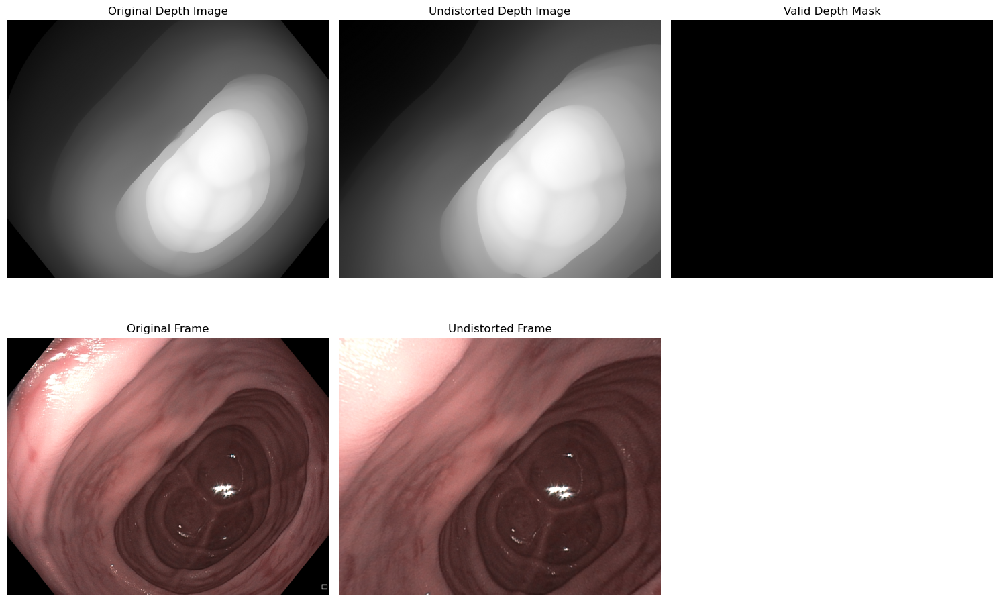

Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 95.26512908935547
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 95.09422302246094
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 94.90806579589844
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 94.6150894165039
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 94.28244018554688
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 94.06118774414062
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 93.87197875976562
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range:

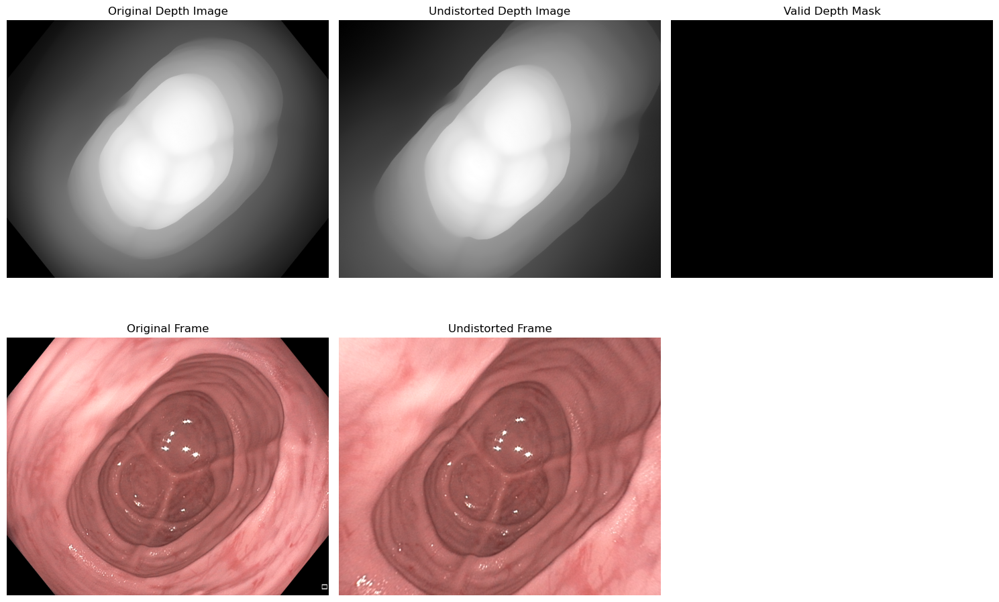

Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 91.76165771484375
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 89.2683334350586
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 86.08834838867188
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 83.09147644042969
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 80.98878479003906
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 79.53459930419922
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 78.97611999511719
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range:

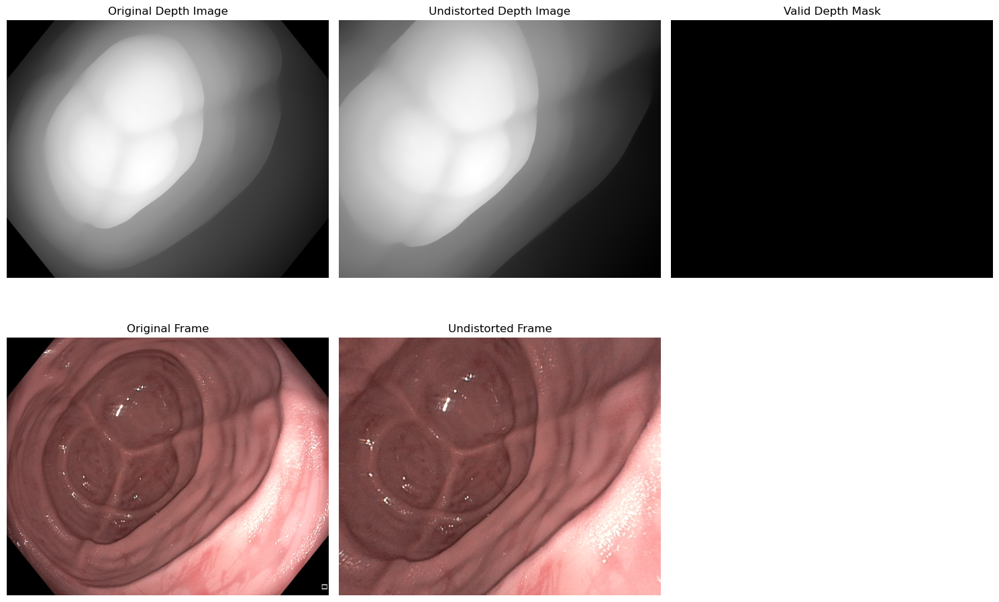

Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 71.38628387451172
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 67.42198944091797
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 64.28168487548828
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 61.944000244140625
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 60.094608306884766
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 58.96696472167969
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 58.548866271972656
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value ra

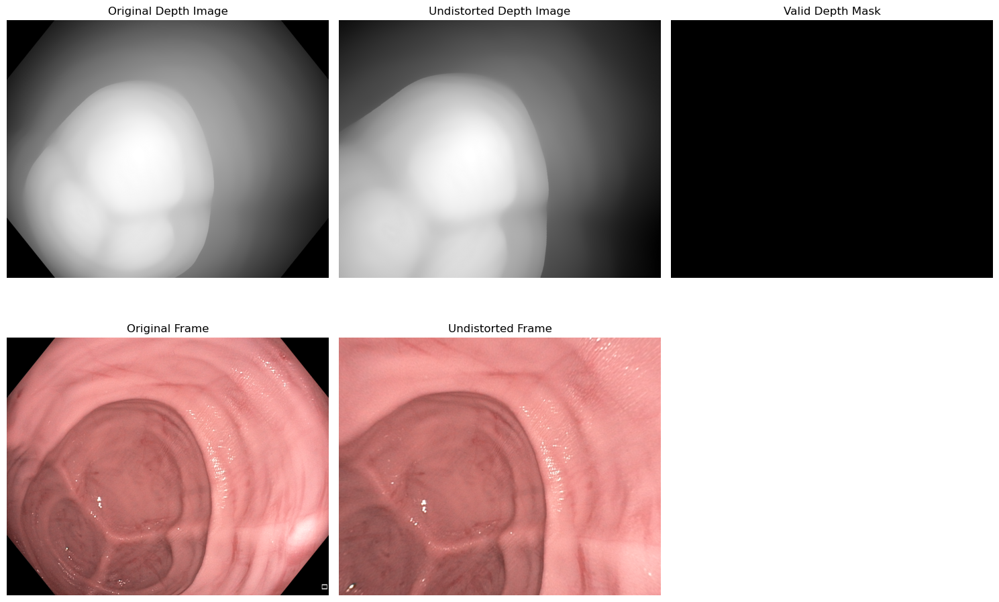

Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 60.68512725830078
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 61.81582260131836
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 63.08079528808594
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 64.29694366455078
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 65.36354064941406
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 66.27909088134766
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range: 0.0 - 66.70329284667969
Number of valid depth pixels: 1458000
Depth image shape: (1080, 1350), data type: float32
Depth value range

In [20]:
#Undistort all depth maps and frames for the video
undistorted_depth_1fps = []
undistorted_frame_1fps = []
need_to_undistort = True

if need_to_undistort:
    for i in range(0, len(frame_paths_1fps)):
        display = False
        depth_path = depth_maps_1fps[i]
        frame_path = frame_paths_1fps[i]
        depth_filename = os.path.basename(depth_path)
        frame_filename = os.path.basename(frame_path)
        if i % 10 == 0:
            display = True
        undistorted_depth, undistorted_frame = undistort_images(depth_path, frame_path, display=display)
        undistorted_depth_1fps.append(undistorted_depth)
        undistorted_frame_1fps.append(undistorted_frame)

        # Saving undistorted images
        # undistorted_depth_uint16 = (undistorted_depth / 100 * (2**16-1)).astype(np.uint16)
        # cv2.imwrite(os.path.join(output_dir, "depth", depth_filename), undistorted_depth_uint16)
        # cv2.imwrite(os.path.join(output_dir, "frames", frame_filename), undistorted_frame)




### Estimate pose

In [21]:
def estimate_pose(kpts0, kpts1, K0, K1, thresh, conf=0.99999):
    if len(kpts0) < 5:
        print("\nNot enough keypoints to estimate pose.\n")
        return None

    # try normalizing by max of both K0 and K1 instead
    # normalize keypoints
    kpts0 = (kpts0 - K0[[0, 1], [2, 2]][None]) / K0[[0, 1], [0, 1]][None]
    kpts1 = (kpts1 - K1[[0, 1], [2, 2]][None]) / K1[[0, 1], [0, 1]][None]

    # normalize ransac threshold
    ransac_thr = thresh / np.mean([K0[0, 0], K1[1, 1], K0[0, 0], K1[1, 1]])

    # compute pose with cv2
    E, mask = cv2.findEssentialMat(
        kpts0, kpts1, np.eye(3), threshold=ransac_thr, prob=conf, method=cv2.USAC_MAGSAC)
    if E is None:
        print("\nE is None while trying to recover pose.\n")
        return None

    # recover pose from E
    best_num_inliers = 0
    ret = None
    for _E in np.split(E, len(E) / 3):
        n, R, t, _ = cv2.recoverPose(_E, kpts0, kpts1, np.eye(3), 1e9, mask=mask)
        if n > best_num_inliers:
            ret = (R, t[:, 0], mask.ravel() > 0, _E)
            best_num_inliers = n
    
    # if best_num_inliers < 10:
    #     print(f"[estimate_pose] Not enough inliers: {best_num_inliers}")
    #     return None



    return ret

### Calculate error

In [22]:
#Sierras code:
def relative_pose_error(T_0to1, R, t, ignore_gt_t_thr=0.0):
    # angle error between 2 vectors
    t_gt = T_0to1[:3,3]

    # Get magnitudes of both translations
    t_mag = np.linalg.norm(t)
    t_gt_mag = np.linalg.norm(t_gt)

    # Handle small translation cases
    if t_mag < 1e-5 or t_gt_mag < 1e-5:
        if t_gt_mag < ignore_gt_t_thr:  # pure rotation case
            print("Pure rotation case, ignore translation error.")
            t_err = 0
        else:
            # If one is small and the other isn't, use 90 degrees as the error
            t_err = 90.0
    else:
        # Compute the angle without caring about sign (take absolute value)
        cos_angle = np.abs(np.dot(t, t_gt)) / (t_mag * t_gt_mag)
        cos_angle = np.clip(cos_angle, 0.0, 1.0)  # Ensure it's between 0 and 1
        t_err = np.rad2deg(np.arccos(cos_angle))

    # angle error between 2 rotation matrices
    R_gt = T_0to1[:3, :3]
    cos = (np.trace(np.dot(R.T, R_gt)) - 1) / 2
    cos = np.clip(cos, -1., 1.)  # handle numerical errors
    R_err = np.rad2deg(np.abs(np.arccos(cos)))

    return t_err, R_err

# t_err, r_err = relative_pose_error(T21_gt, R, t, ignore_gt_t_thr=0.0)

### Helper functions

In [23]:
import matplotlib.pyplot as plt
import numpy as np

def plot_reproj_error_vs_depth(mkpts1, warped_pts1, depths, title='Reprojection Error vs. Depth'):
    # Ensure valid points (i.e., skip NaNs or zero-depths)
    valid_mask = np.isfinite(depths) & (depths > 0)
    mkpts1 = mkpts1[valid_mask]
    warped_pts1 = warped_pts1[valid_mask]
    depths = depths[valid_mask]

    # Compute L2 distance (reprojection error per keypoint)
    errors = np.linalg.norm(mkpts1 - warped_pts1, axis=1)

    # Plot
    plt.figure(figsize=(8, 5))
    plt.scatter(depths, errors, s=10, alpha=0.6, c='blue')
    plt.xlabel("Depth (mm or m, depending on your scale)")
    plt.ylabel("Reprojection Error (pixels)")
    plt.title(title)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Optional: print stats
    print(f"Mean reprojection error: {np.mean(errors):.2f} px")
    print(f"Median reprojection error: {np.median(errors):.2f} px")


In [24]:
# import matplotlib.pyplot as plt
# import numpy as np

# def plot_error_vs_depth_colored(mkpts0, mkpts1, warped_pts1, depths, image_shape, title="Reprojection Error vs Depth (Color = Radial Pos)"):
#     # Compute error
#     errors = np.linalg.norm(mkpts1 - warped_pts1, axis=1)
    
#     # Filter out invalid depths
#     valid_mask = np.isfinite(depths) & (depths > 0)
#     mkpts0 = mkpts0[valid_mask]
#     errors = errors[valid_mask]
#     depths = depths[valid_mask]

#     # Compute radial distance from image center
#     h, w = image_shape[:2]
#     cx, cy = w / 2, h / 2
#     radial_dist = np.linalg.norm(mkpts0 - np.array([cx, cy]), axis=1)

#     # Normalize radial distance for coloring
#     radial_norm = (radial_dist - np.min(radial_dist)) / (np.max(radial_dist) - np.min(radial_dist))

#     # Plot
#     plt.figure(figsize=(8, 5))
#     sc = plt.scatter(depths, errors, c=radial_norm, cmap='viridis', s=10, alpha=0.7)
#     plt.xlabel("Depth (mm)")
#     plt.ylabel("Reprojection Error (pixels)")
#     plt.title(title)
#     plt.colorbar(sc, label="Normalized radial position")
#     plt.grid(True)
#     plt.tight_layout()
#     plt.show()


In [25]:
def warp_kpts_with_depth_compare(gt_pose, est_pose, kpts0, depth_map, K, img0=None, img1=None, kpts1=None, frame_idx=0, step=30, visualize=True):
    """
    Warp keypoints from img0 to img1 using GT and estimated relative poses, then overlay both on img1.

    Args:
        gt_pose: GT relative pose T12_gt (4x4)
        est_pose: Estimated relative pose T12_est (4x4)
        kpts0: Nx2 keypoints in img0
        depth_map: undistorted depth map of img0
        K: camera intrinsics
        img0, img1: images
        kpts1: keypoints in img1 (match targets)
        frame_idx: for labeling
        step: frame step between images
        visualize: whether to show the projection visualization

    Returns:
        kpts_warped_gt: Projected points using GT pose
        kpts_warped_est: Projected points using estimated pose
        reprojection_error: Mean reprojection error in pixels
    """
    K_inv = np.linalg.inv(K)
    n = frame_idx * step

    # Sample depths at keypoint locations
    depths = sample_depths(depth_map, kpts0) * 1000  # Assuming depth in meters, scale to mm if needed

    # Backproject to 3D
    kpts0_h = np.hstack([kpts0, np.ones((kpts0.shape[0], 1))])
    normalized = (K_inv @ kpts0_h.T).T
    points_3d = normalized * depths[:, None]

    # Create homogeneous 3D points
    points_3d_h = np.hstack([points_3d, np.ones((points_3d.shape[0], 1))])

    # Warp with GT and estimated pose
    def project(T):
        pts = (T @ points_3d_h.T).T[:, :3]
        proj = (K @ pts.T).T
        return proj[:, :2] / proj[:, 2:3]

    kpts_warped_gt = project(gt_pose)
    kpts_warped_est = project(est_pose)

    # Compute reprojection error
    valid = np.isfinite(kpts_warped_gt).all(axis=1) & np.isfinite(kpts_warped_est).all(axis=1)
    if valid.any():
        reprojection_error = np.linalg.norm(kpts_warped_gt[valid] - kpts_warped_est[valid], axis=1).mean()
    else:
        reprojection_error = float('nan')

    # Visualization
    if visualize and img1 is not None:
        plt.figure(figsize=(8, 6))
        plt.imshow(img1)

        if kpts1 is not None:
            plt.scatter(kpts1[:, 0], kpts1[:, 1], s=10, c='red', label='Matched Keypoints (kpts1)')
        plt.scatter(kpts_warped_gt[:, 0], kpts_warped_gt[:, 1], s=10, c='lime', label='Warped (GT Pose)')
        plt.scatter(kpts_warped_est[:, 0], kpts_warped_est[:, 1], s=10, c='cyan', label='Warped (Estimated Pose)')

        plt.legend()
        plt.title(f"Projected Keypoints from Frame {n} to Frame {n+step}")
        plt.axis('off')
        plt.show()

    return kpts_warped_gt, kpts_warped_est, reprojection_error

In [26]:
def invert_transform(T):
    """
    Invert a 4x4 rigid body transformation matrix.
    T: np.ndarray of shape (4, 4)
    """
    R = T[:3, :3]
    t = T[:3, 3]
    T_inv = np.eye(4)
    T_inv[:3, :3] = R.T
    T_inv[:3, 3] = -R.T @ t
    return T_inv


In [27]:
def scale_translation(transformation_matrix, scale_factor=0.01):
    # Create a copy to avoid modifying the original
    scaled_matrix = transformation_matrix.copy()

    # Scale the translation components (first three elements of the last column)
    scaled_matrix[0:3, 3] *= scale_factor

    return scaled_matrix

In [28]:
from scipy.ndimage import map_coordinates

def sample_depths(depth_map, kpts):
    u = kpts[:, 0]  # x / col
    v = kpts[:, 1]  # y / row
    return map_coordinates(depth_map, [v, u], order=1, mode='nearest')


In [29]:
# def visualize_projection_error(gt,img1, kpts1, warped_kpts0, gt_matches=None, scale_factor=1.0, save_path=None):
#     """
#     Visualize the projection error between warped keypoints and actual keypoints in the second image.

#     """

#     fig, ax = plt.subplots(figsize=(6, 5))

#     # Display the second image
#     ax.imshow(img1)
#     label1= 'Actual keypoints'
#     label2= 'Warped keypoints'
#     if gt:
#       label1 = 'Matched keypoints'
#       label2 = 'Ground truth keypoints (transformed from img0)'

#     # Plot the keypoints
#     ax.scatter(kpts1[:, 0], kpts1[:, 1],
#                 s=5, c='green', marker='o', label=label1)
#     ax.scatter(warped_kpts0[:, 0], warped_kpts0[:, 1],
#                 s=5, c='red', marker='x', label=label2)
#     ax.set_title('Keypoints Comparison', fontsize=14)

#     ax.legend(loc='upper right')
#     ax.set_xticks([])
#     ax.set_yticks([])

#     plt.tight_layout()

#     if save_path is not None:
#         plt.savefig(save_path, bbox_inches='tight', dpi=150)

#     return fig

### Feature tracking

In [30]:
def update_tracks_from_pair(tracks, mkpts0, mkpts1, frame0, frame1, threshold=2.0):
    global track_id_counter
    from scipy.spatial import cKDTree

    # Build index from mkpts0 to track IDs (existing observations)
    pt_to_track = {}
    for tid, obs in tracks.items():
        for f, pt in obs:
            if f == frame0:
                pt_to_track[tuple(pt)] = tid

    tree0 = cKDTree([tuple(p) for p in mkpts0])
    tree1 = cKDTree([tuple(p) for p in mkpts1])

    for idx0, pt0 in enumerate(mkpts0):
        pt0_tuple = tuple(pt0)
        pt1_tuple = tuple(mkpts1[idx0])

        # Try to find existing track from frame0
        existing_tid = None
        distances, indices = tree0.query([pt0_tuple], k=1)
        if distances[0] < threshold and pt0_tuple in pt_to_track:
            existing_tid = pt_to_track[pt0_tuple]

        if existing_tid:
            tracks[existing_tid].append((frame1, pt1_tuple))
        else:
            # Start a new track
            tracks[track_id_counter] = [(frame0, pt0_tuple), (frame1, pt1_tuple)]
            track_id_counter += 1

    return tracks


### Main


In [ ]:
# To be able to user the matcher- undistorted frames need to be given as a filepath 

u_frames_dir = Path(f'/home/honor/my_project/data/C3VD/{video_name}/undistorted/frames')
u_depth_dir = Path(f'/home/honor/my_project/data/C3VD/{video_name}/undistorted/depth')
undistorted_frame_paths = sorted(u_frames_dir.glob('*_color.png'), key=lambda x: int(x.stem.split('_')[0]))
undistorted_depth_paths = sorted(u_depth_dir.glob('*_color.tiff'), key=lambda x: int(x.stem.split('_')[0]))
print("Number of frames in undistorted frame directory:", len(undistorted_frame_paths))
undistorted_frame_paths_1fps = undistorted_frame_paths[::image_step]  
undistorted_depth_paths_1fps = undistorted_depth_paths[::image_step] #not used
print("Number of frames in undistorted frame paths 1fps:", len(undistorted_frame_paths_1fps))

estimated_relative_poses = []


Number of frames in undistorted frame directory: 39
Number of frames in undistorted frame paths 1fps: 39


In [32]:
def load_frame_pair(index0, index1, matcher, undistort_first=True, image_size=512):
    if undistort_first:
        img0 = matcher.load_image(undistorted_frame_paths_1fps[index0])
        img1 = matcher.load_image(undistorted_frame_paths_1fps[index1])
        depth_image_0 = undistorted_depth_1fps[index0]
        depth_image_1 = undistorted_depth_1fps[index1]
    else:
        img0 = matcher.load_image(frame_paths_1fps[index0], resize=image_size)
        img1 = matcher.load_image(frame_paths_1fps[index1], resize=image_size)
        depth_image_0 = depth_paths_1fps[index0]
        depth_image_1 = depth_paths_1fps[index1]
    return img0, img1, depth_image_0, depth_image_1


def run_pose_estimation(mkpts0, mkpts1, K):
    try:
        T12_est = estimate_pose(mkpts0, mkpts1, K, K, thresh=0.5)
        if T12_est is None:
            return None
        R, t, inliers, E = T12_est
        return R, t
    except Exception as e:
        return None


def compute_metrics(R, t, T12_gt, mkpts0, mkpts1, depth_image_0, K, img0, img1, frame_idx, visualize=False):
    T21_gt = np.linalg.inv(T12_gt)
    T12_est_pose = np.eye(4)
    T12_est_pose[:3, :3] = R
    T12_est_pose[:3, 3] = t

    _, _, reproj_err = warp_kpts_with_depth_compare(
        gt_pose=T21_gt,
        est_pose=T12_est_pose,
        kpts0=mkpts0,
        depth_map=depth_image_0,
        K=K,
        img0=img0.permute(1, 2, 0).cpu().numpy(),
        img1=img1.permute(1, 2, 0).cpu().numpy(),
        kpts1=mkpts1,
        frame_idx=frame_idx,
        step=30,
        visualize=visualize
    )

    t_err, r_err = relative_pose_error(T21_gt, R, t, ignore_gt_t_thr=0.0)
    return t_err, r_err, reproj_err


def plot_single_matcher_metrics(metrics_df, matcher_name):
    clean_df = metrics_df.dropna()

    for metric, ylabel in [
        ('translation_error', 'Translation Error (degrees)'),
        ('rotation_error', 'Rotation Error (degrees)'),
        ('reprojection_error', 'Reprojection Error (pixels)')
    ]:
        plt.figure()
        plt.plot(clean_df['frame'], clean_df[metric], color='gray', linestyle='-', zorder=1)
        scatter = plt.scatter(clean_df['frame'], clean_df[metric], c=clean_df['skip'], cmap='viridis', marker='o', zorder=2)
        plt.title(f"{ylabel} - {matcher_name} (colored by skip)")
        plt.xlabel('Frame Index')
        plt.ylabel(ylabel)
        plt.colorbar(scatter).set_label('Number of Skips')
        plt.grid(True)
        plt.show()


def plot_combined_matcher_comparison(all_metrics):
    all_df = pd.concat(all_metrics, ignore_index=True).dropna()

    for metric, ylabel in [
        ('rotation_error', 'Rotation Error (degrees)'),
        ('translation_error', 'Translation Error (degrees)'),
        ('skip', 'Number of Skips'),
        ('reprojection_error', 'Reprojection Error (pixels)')
    ]:
        plt.figure()
        for matcher_name in all_df['matcher'].unique():
            subset = all_df[all_df['matcher'] == matcher_name]
            plt.plot(subset['frame'], subset[metric], label=matcher_name)
        plt.title(f"{ylabel} Comparison Across Matchers")
        plt.xlabel("Frame Index")
        plt.ylabel(ylabel)
        plt.legend()
        plt.grid(True)
        plt.show()




In [33]:
import numpy as np
import plotly.graph_objects as go

def compute_global_poses(relative_poses):
    """Compose global poses from relative ones."""
    T_global = [np.eye(4)]
    for T in relative_poses:
        T_next = T @ T_global[-1]  # Compose transformation
        T_global.append(T_next)
    return T_global

def extract_translation_vectors(T_list):
    return np.array([T[:3, 3] for T in T_list])  # Nx3

def plot_trajectory_plotly(positions, title="Estimated Camera Trajectory"):
    import plotly.graph_objects as go

    fig = go.Figure()

    # Main trajectory (lines + points)
    fig.add_trace(go.Scatter3d(
        x=positions[:, 0], y=positions[:, 1], z=positions[:, 2],
        mode='lines+markers',
        marker=dict(size=4, color='red'),
        line=dict(color='blue', width=2),
        name="Camera Path"
    ))

    # Special marker for the first position (green)
    fig.add_trace(go.Scatter3d(
        x=[positions[0, 0]], y=[positions[0, 1]], z=[positions[0, 2]],
        mode='markers',
        marker=dict(size=6, color='green', symbol='circle'),
        name="Start"
    ))

    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='X', yaxis_title='Y', zaxis_title='Z',
            aspectmode='data'
        ),
        margin=dict(l=0, r=0, b=0, t=40)
    )

    fig.show()



Matching with gim-lg
Frame 0 of 39
Translation error: 72.41°, Rotation error: 0.08°
Frame 1 of 39


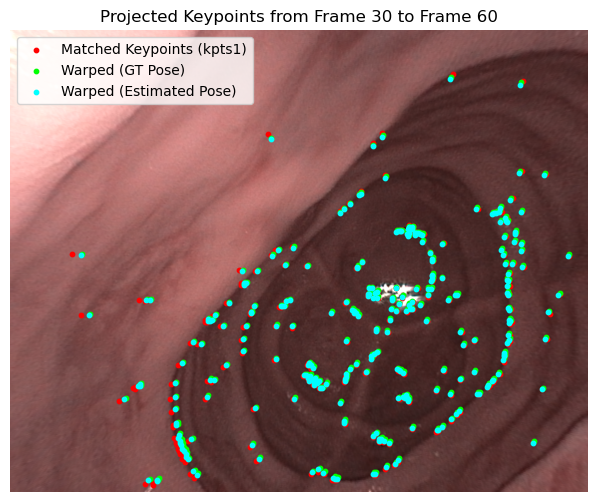

Translation error: 55.71°, Rotation error: 0.29°
Frame 2 of 39
Translation error: 62.32°, Rotation error: 0.28°
Frame 3 of 39
Translation error: 62.16°, Rotation error: 1.03°
Frame 4 of 39
Translation error: 62.38°, Rotation error: 0.49°
Frame 5 of 39
[ERROR] Pose estimation failed for frame 5 with skip 1
Translation error: 87.64°, Rotation error: 1.35°
Frame 7 of 39
[ERROR] Pose estimation failed for frame 7 with skip 1
[ERROR] Pose estimation failed for frame 7 with skip 2
Translation error: 48.33°, Rotation error: 0.56°
Frame 10 of 39
Translation error: 63.04°, Rotation error: 0.26°
Frame 11 of 39


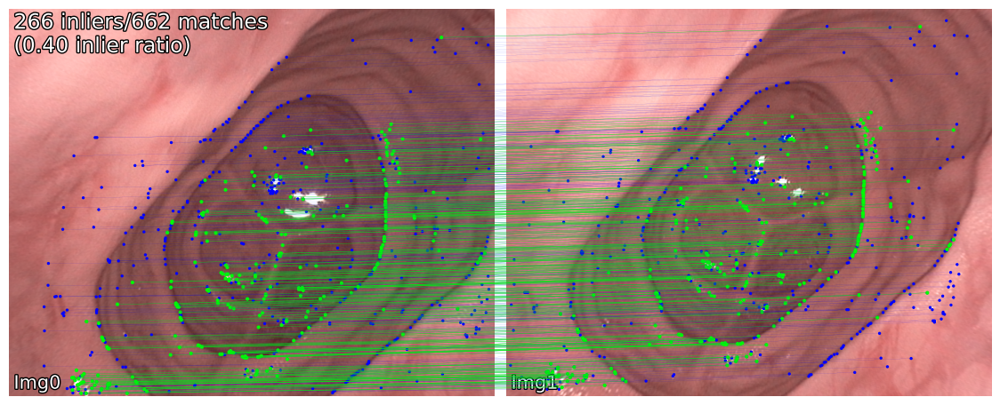

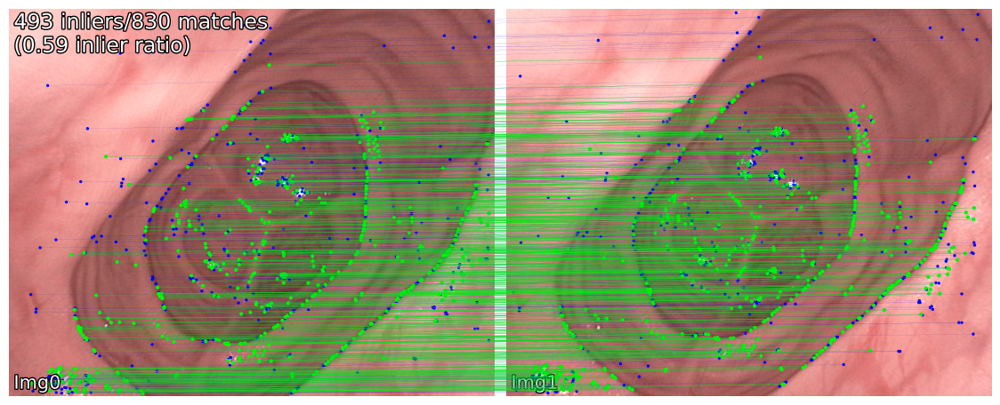

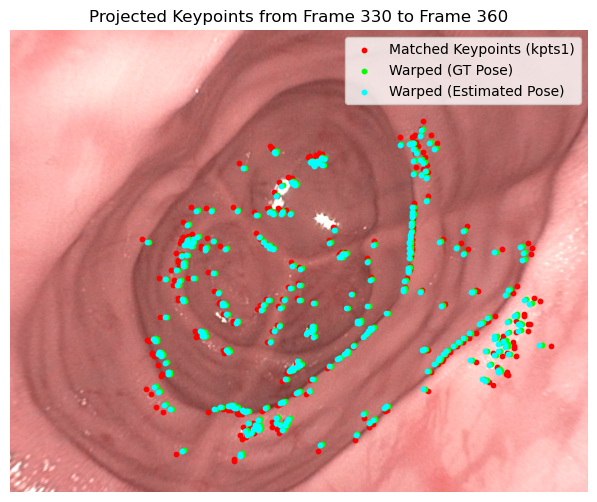

Translation error: 69.30°, Rotation error: 0.29°
Frame 12 of 39
Translation error: 60.37°, Rotation error: 0.36°
Frame 13 of 39
Translation error: 60.16°, Rotation error: 0.05°
Frame 14 of 39
Translation error: 53.42°, Rotation error: 0.17°
Frame 15 of 39
Translation error: 60.24°, Rotation error: 0.16°
Frame 16 of 39
Translation error: 59.51°, Rotation error: 0.21°
Frame 17 of 39
Translation error: 58.89°, Rotation error: 0.17°
Frame 18 of 39
Translation error: 62.16°, Rotation error: 0.23°
Frame 19 of 39
Translation error: 58.97°, Rotation error: 0.31°
Frame 20 of 39
Translation error: 59.79°, Rotation error: 0.48°
Frame 21 of 39


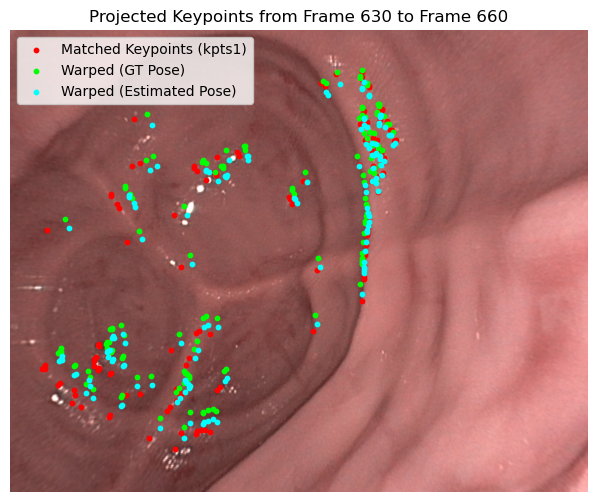

Translation error: 37.79°, Rotation error: 1.64°
Frame 22 of 39
Translation error: 62.68°, Rotation error: 0.95°
Frame 23 of 39
Translation error: 36.87°, Rotation error: 2.74°
Frame 24 of 39
Translation error: 59.80°, Rotation error: 0.26°
Frame 25 of 39
Translation error: 42.75°, Rotation error: 1.10°
Frame 26 of 39
Translation error: 73.72°, Rotation error: 0.46°
Frame 27 of 39
Translation error: 87.18°, Rotation error: 0.09°
Frame 28 of 39
Translation error: 86.05°, Rotation error: 0.27°
Frame 29 of 39
Translation error: 79.77°, Rotation error: 0.33°
Frame 30 of 39
Translation error: 75.27°, Rotation error: 1.16°
Frame 31 of 39


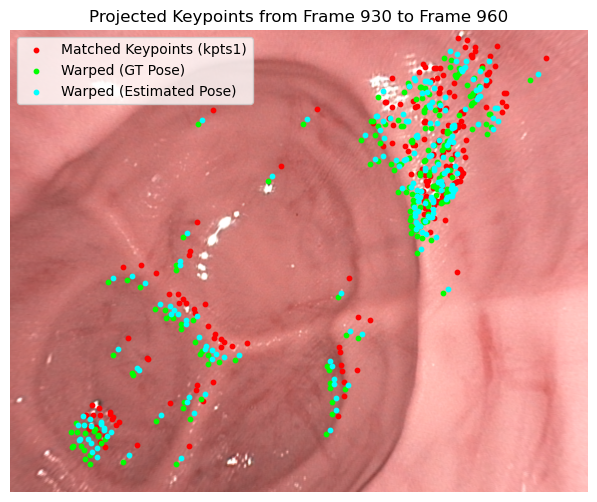

Translation error: 74.92°, Rotation error: 0.98°
Frame 32 of 39
Translation error: 73.41°, Rotation error: 1.58°
Frame 33 of 39
Translation error: 72.13°, Rotation error: 0.42°
Frame 34 of 39
Translation error: 71.78°, Rotation error: 0.35°
Frame 35 of 39
Translation error: 70.79°, Rotation error: 0.30°
Frame 36 of 39
Translation error: 61.79°, Rotation error: 0.24°
Frame 37 of 39
Translation error: 12.79°, Rotation error: 0.13°
Frame 38 of 39
[SKIP] No valid pose found for frame 38 within 5 skips


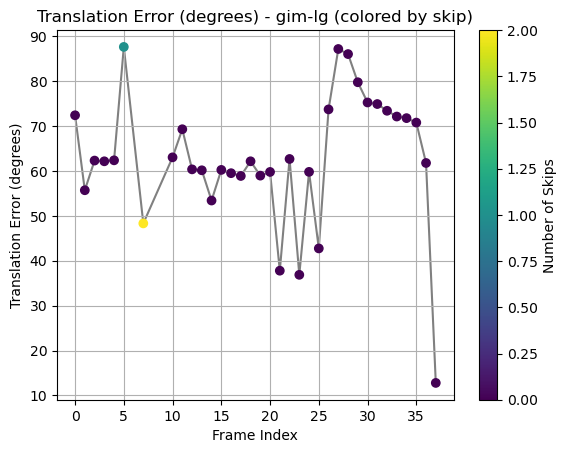

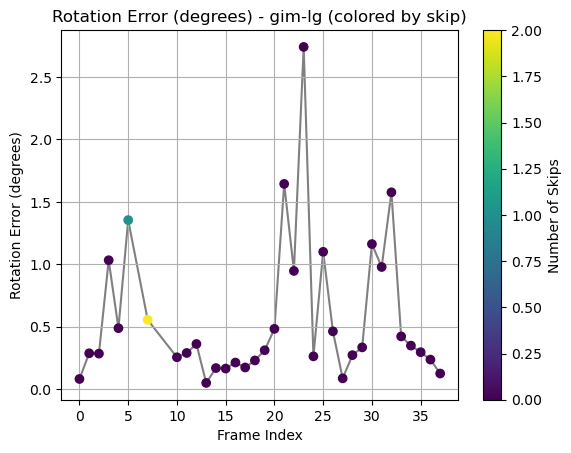

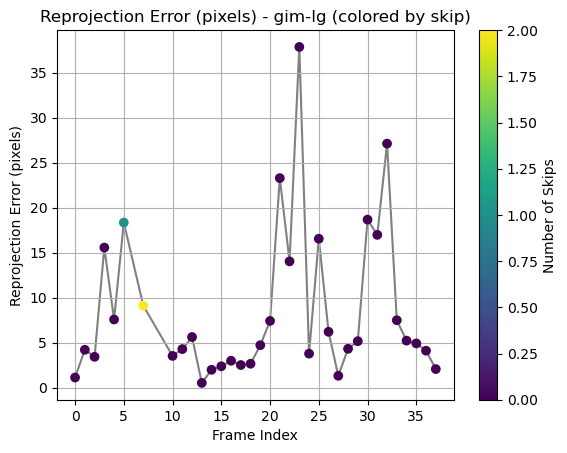

Matching with xfeat
Frame 0 of 39
Translation error: 66.86°, Rotation error: 0.18°
Frame 1 of 39


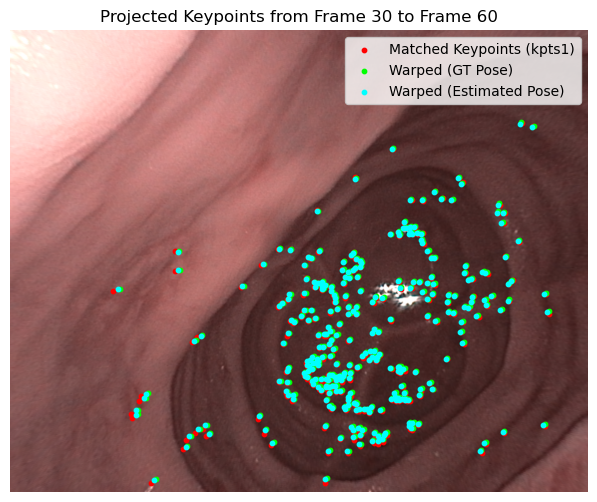

Translation error: 64.63°, Rotation error: 0.26°
Frame 2 of 39
Translation error: 57.89°, Rotation error: 0.56°
Frame 3 of 39
Translation error: 73.72°, Rotation error: 1.58°
Frame 4 of 39
Translation error: 73.75°, Rotation error: 1.73°
Frame 5 of 39
Translation error: 57.47°, Rotation error: 0.51°
Frame 6 of 39
Translation error: 78.31°, Rotation error: 0.56°
Frame 7 of 39
[ERROR] Pose estimation failed for frame 7 with skip 1
[ERROR] Pose estimation failed for frame 7 with skip 2
Translation error: 68.80°, Rotation error: 0.48°
Frame 10 of 39
Translation error: 72.21°, Rotation error: 0.44°
Frame 11 of 39


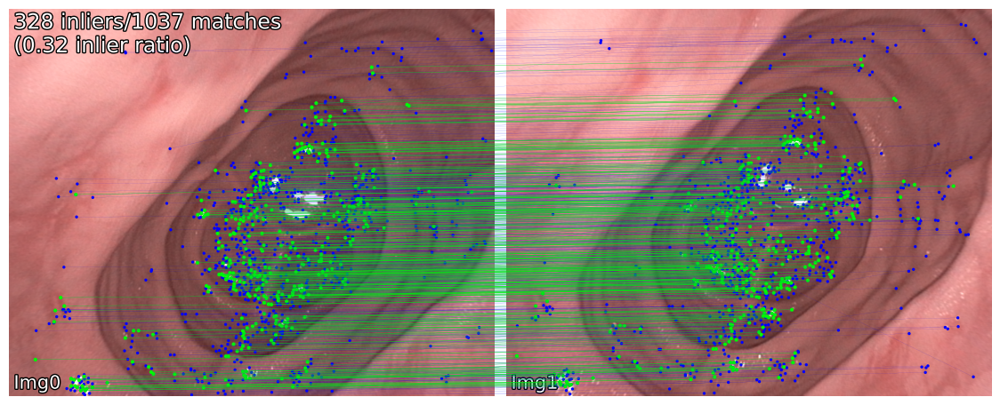

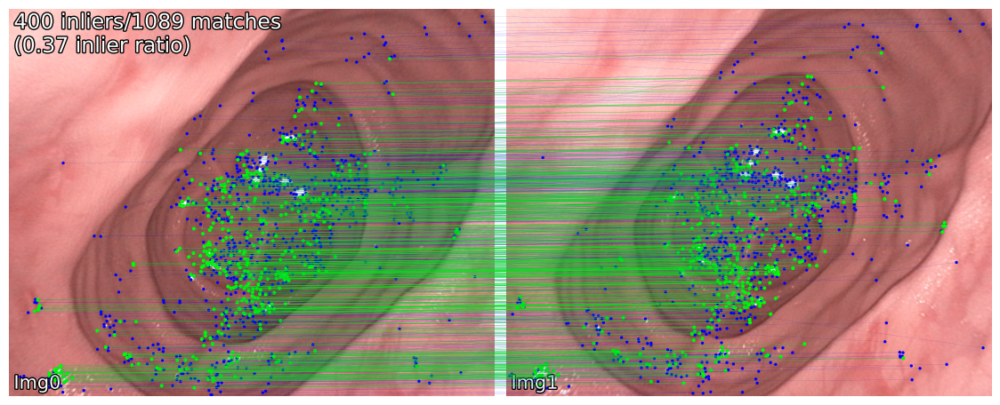

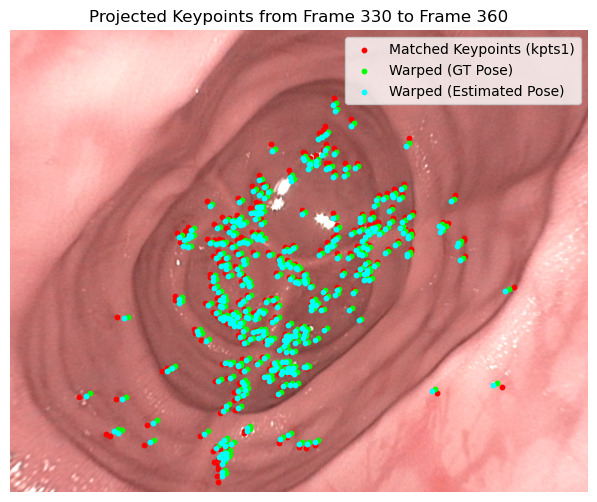

Translation error: 68.98°, Rotation error: 0.54°
Frame 12 of 39
Translation error: 64.88°, Rotation error: 1.32°
Frame 13 of 39
Translation error: 69.56°, Rotation error: 1.73°
Frame 14 of 39
Translation error: 67.74°, Rotation error: 1.50°
Frame 15 of 39
Translation error: 76.63°, Rotation error: 0.62°
Frame 16 of 39
Translation error: 78.64°, Rotation error: 0.40°
Frame 17 of 39
Translation error: 16.44°, Rotation error: 0.09°
Frame 18 of 39
Translation error: 53.99°, Rotation error: 0.20°
Frame 19 of 39
Translation error: 44.98°, Rotation error: 0.33°
Frame 20 of 39
Translation error: 28.27°, Rotation error: 1.34°
Frame 21 of 39


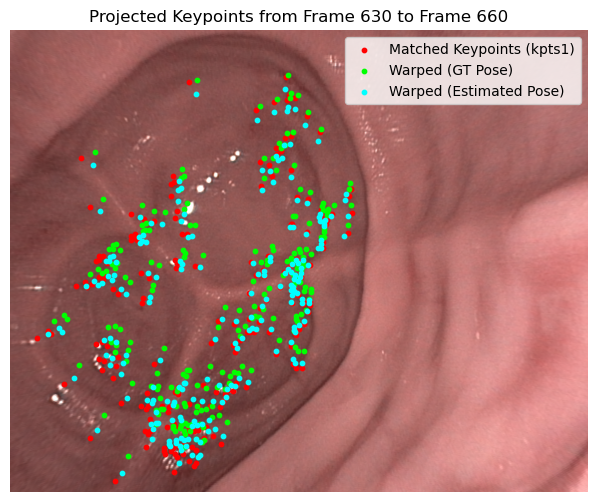

Translation error: 21.46°, Rotation error: 2.00°
Frame 22 of 39
Translation error: 57.34°, Rotation error: 1.05°
Frame 23 of 39
Translation error: 57.51°, Rotation error: 0.78°
Frame 24 of 39
Translation error: 12.95°, Rotation error: 2.14°
Frame 25 of 39
Translation error: 48.79°, Rotation error: 1.04°
Frame 26 of 39
Translation error: 39.37°, Rotation error: 0.91°
Frame 27 of 39
[ERROR] Pose estimation failed for frame 27 with skip 1
Translation error: 73.03°, Rotation error: 0.62°
Frame 29 of 39
Translation error: 73.83°, Rotation error: 0.92°
Frame 30 of 39
Translation error: 75.33°, Rotation error: 0.49°
Frame 31 of 39


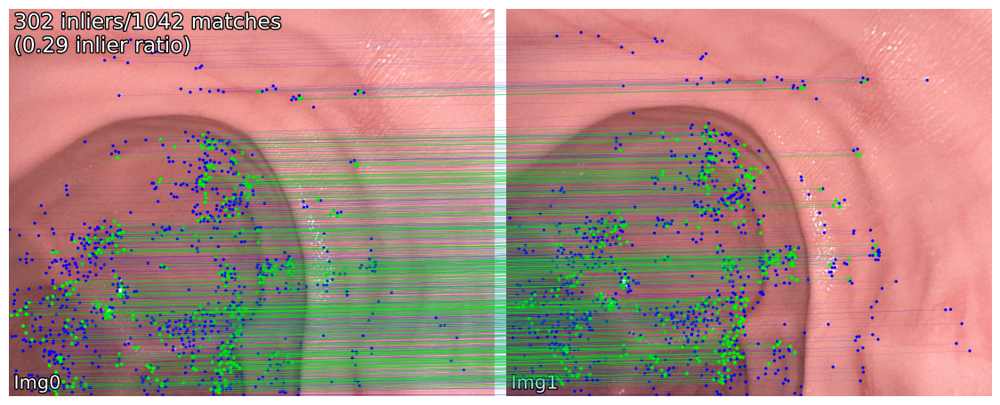

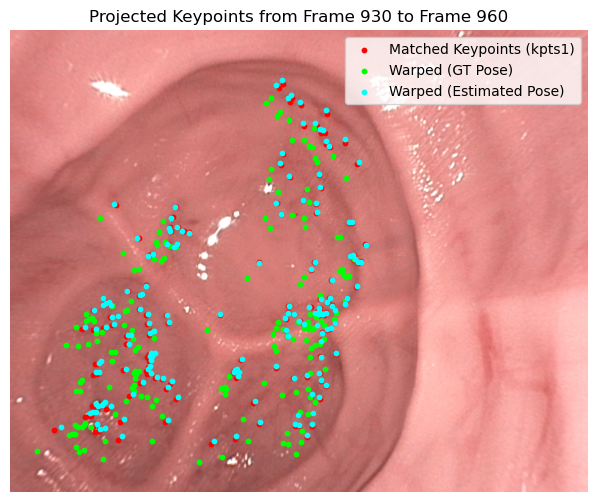

Translation error: 37.16°, Rotation error: 3.22°
Frame 32 of 39
Translation error: 69.35°, Rotation error: 1.34°
Frame 33 of 39
Translation error: 68.11°, Rotation error: 0.88°
Frame 34 of 39
Translation error: 67.87°, Rotation error: 0.59°
Frame 35 of 39
Translation error: 64.69°, Rotation error: 0.44°
Frame 36 of 39
Translation error: 64.00°, Rotation error: 0.27°
Frame 37 of 39
[ERROR] Pose estimation failed for frame 37 with skip 1
[SKIP] No valid pose found for frame 37 within 5 skips
Frame 38 of 39
[SKIP] No valid pose found for frame 38 within 5 skips


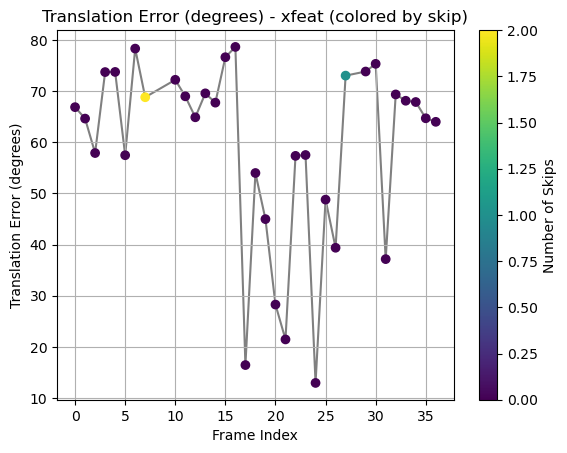

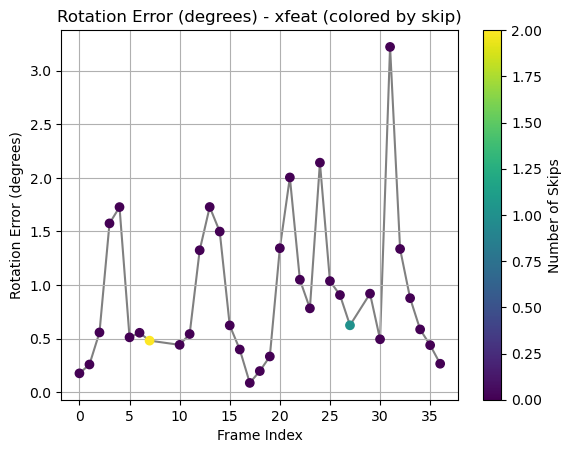

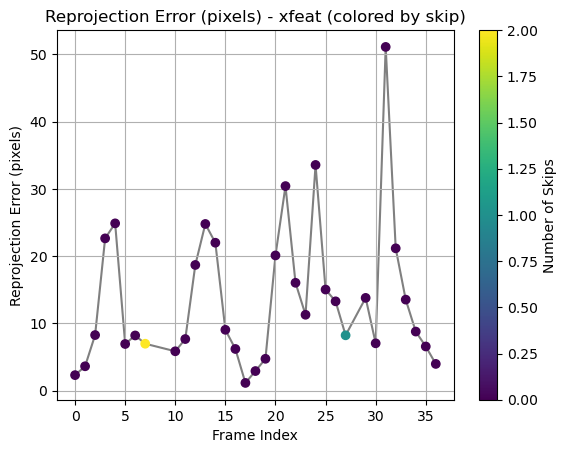

Matching with disk-lg
Frame 0 of 39
Translation error: 61.61°, Rotation error: 0.15°
Frame 1 of 39


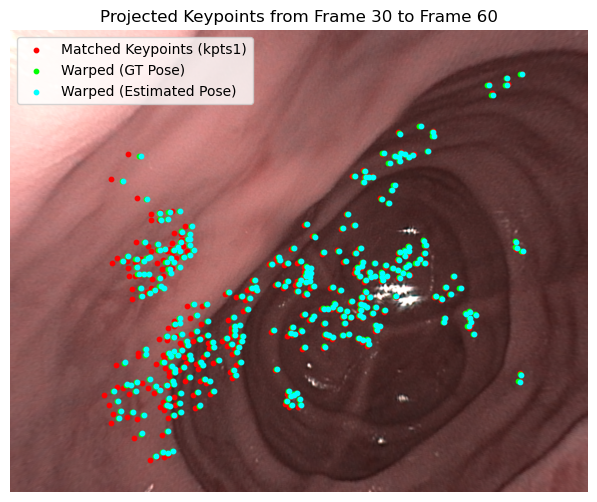

Translation error: 56.52°, Rotation error: 0.19°
Frame 2 of 39
Translation error: 56.07°, Rotation error: 0.20°
Frame 3 of 39
Translation error: 77.13°, Rotation error: 0.94°
Frame 4 of 39
Translation error: 61.36°, Rotation error: 0.67°
Frame 5 of 39
Translation error: 28.92°, Rotation error: 0.62°
Frame 6 of 39
Translation error: 53.85°, Rotation error: 0.13°
Frame 7 of 39
[ERROR] Pose estimation failed for frame 7 with skip 1
[ERROR] Pose estimation failed for frame 7 with skip 2
Translation error: 48.96°, Rotation error: 0.15°
Frame 10 of 39
Translation error: 66.13°, Rotation error: 0.30°
Frame 11 of 39


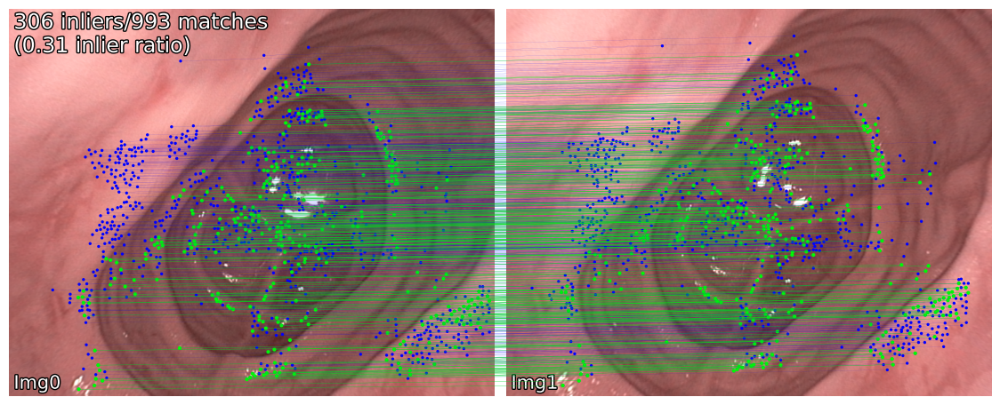

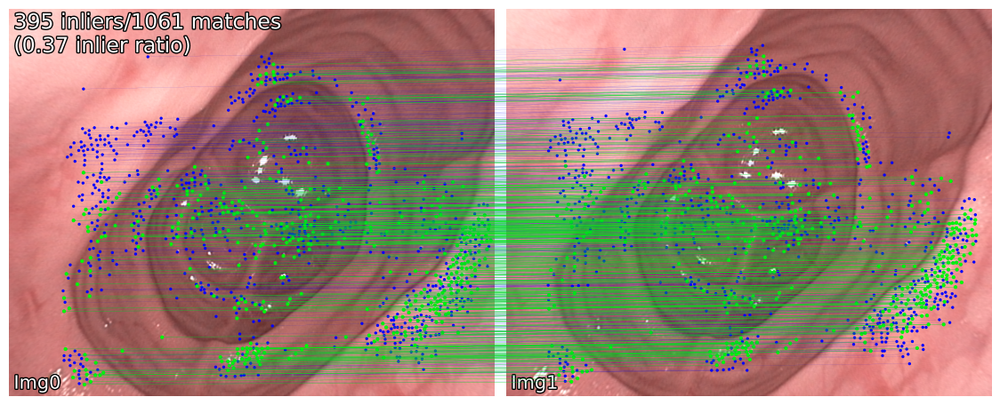

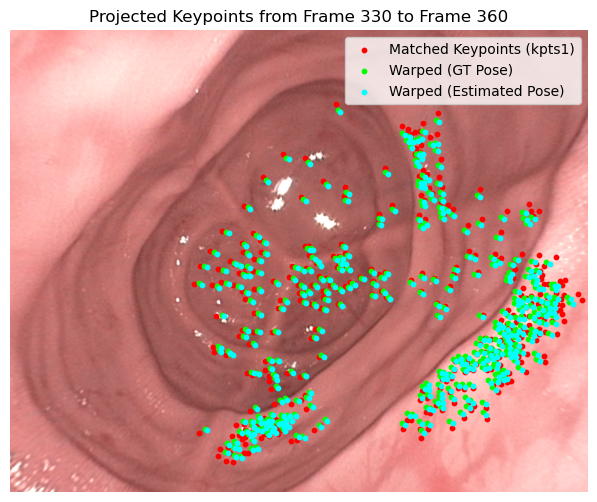

Translation error: 60.20°, Rotation error: 0.50°
Frame 12 of 39
Translation error: 59.44°, Rotation error: 0.41°
Frame 13 of 39
Translation error: 57.82°, Rotation error: 0.29°
Frame 14 of 39
Translation error: 50.13°, Rotation error: 2.63°
Frame 15 of 39
Translation error: 45.83°, Rotation error: 1.97°
Frame 16 of 39
Translation error: 55.89°, Rotation error: 0.12°
Frame 17 of 39
Translation error: 55.55°, Rotation error: 0.12°
Frame 18 of 39
Translation error: 61.80°, Rotation error: 0.15°
Frame 19 of 39
Translation error: 58.61°, Rotation error: 0.24°
Frame 20 of 39
Translation error: 24.82°, Rotation error: 1.64°
Frame 21 of 39


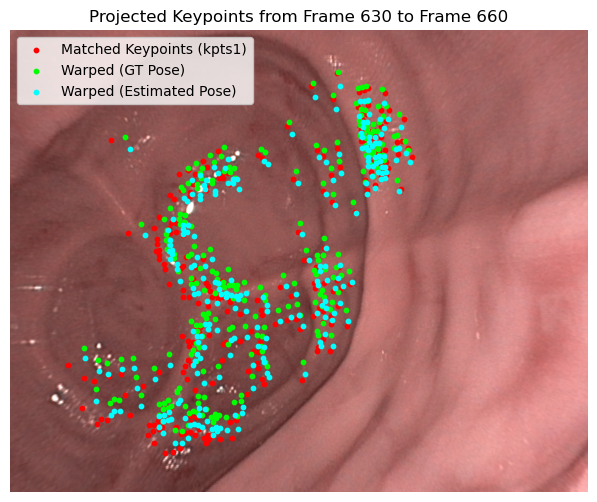

Translation error: 30.68°, Rotation error: 1.93°
Frame 22 of 39
Translation error: 66.64°, Rotation error: 1.07°
Frame 23 of 39
Translation error: 59.02°, Rotation error: 0.56°
Frame 24 of 39
Translation error: 48.28°, Rotation error: 1.09°
Frame 25 of 39
Translation error: 51.23°, Rotation error: 0.80°
Frame 26 of 39
Translation error: 69.97°, Rotation error: 0.40°
Frame 27 of 39
Translation error: 81.33°, Rotation error: 0.07°
Frame 28 of 39
Translation error: 86.21°, Rotation error: 0.33°
Frame 29 of 39
Translation error: 79.07°, Rotation error: 0.81°
Frame 30 of 39
Translation error: 79.47°, Rotation error: 0.77°
Frame 31 of 39


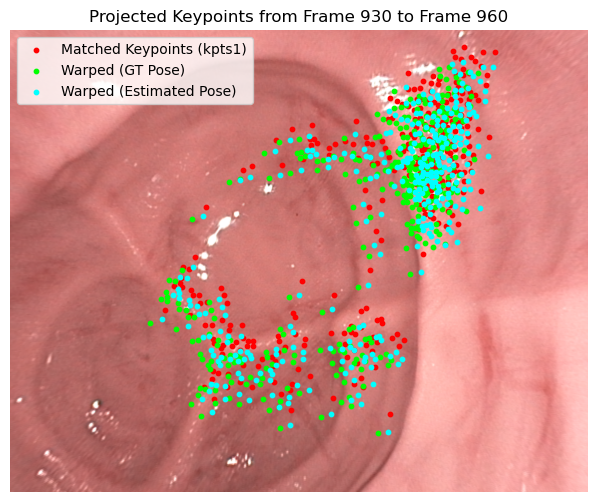

Translation error: 71.38°, Rotation error: 1.83°
Frame 32 of 39
Translation error: 71.21°, Rotation error: 2.11°
Frame 33 of 39
Translation error: 21.80°, Rotation error: 2.79°
Frame 34 of 39
Translation error: 66.76°, Rotation error: 0.59°
Frame 35 of 39
Translation error: 23.21°, Rotation error: 1.23°
Frame 36 of 39
Translation error: 8.96°, Rotation error: 0.75°
Frame 37 of 39
Translation error: 24.44°, Rotation error: 0.13°
Frame 38 of 39
[SKIP] No valid pose found for frame 38 within 5 skips


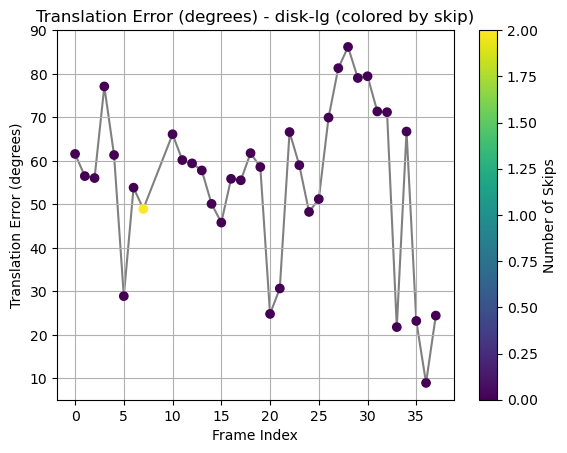

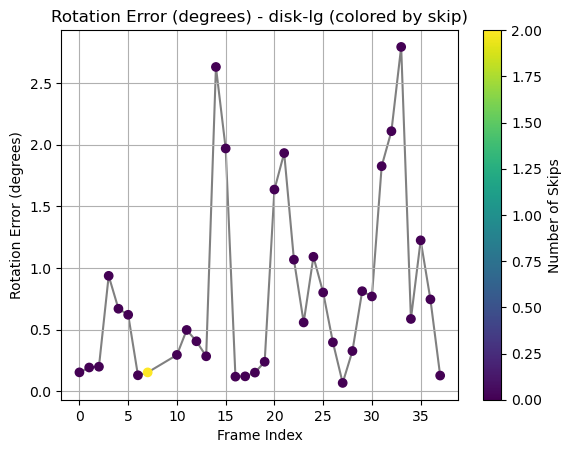

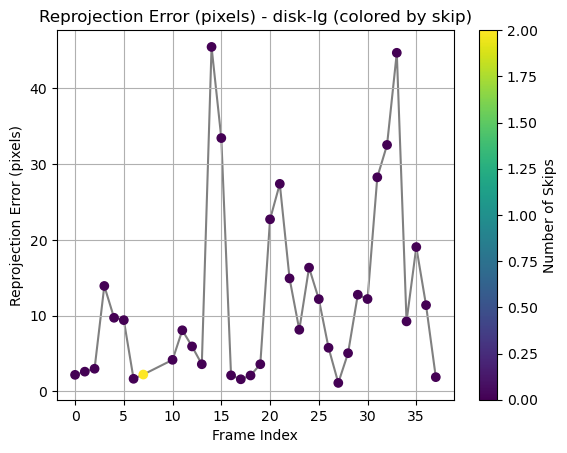

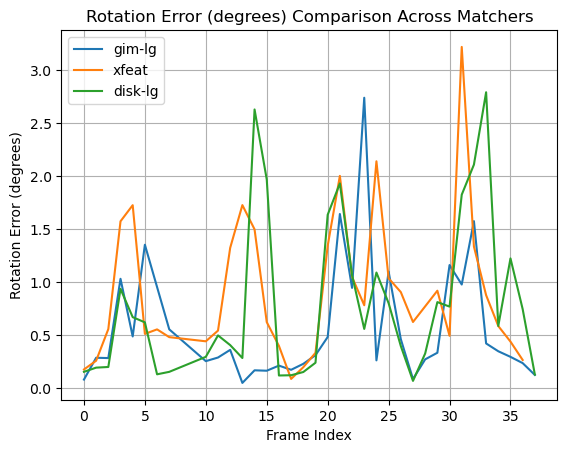

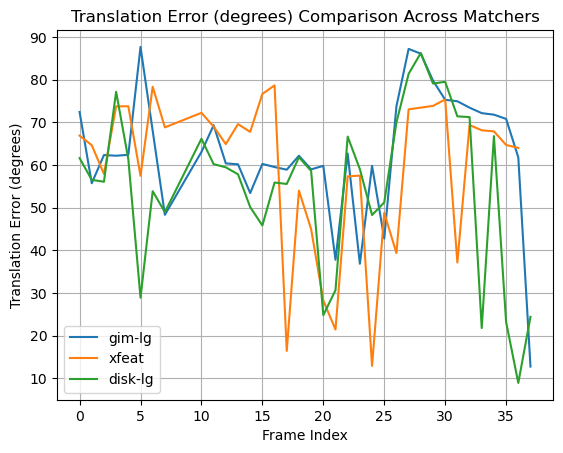

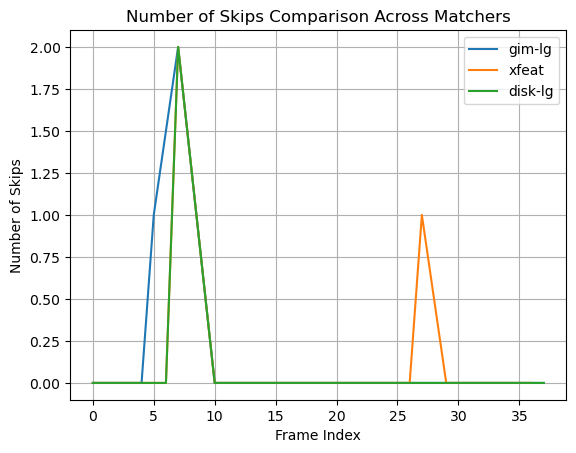

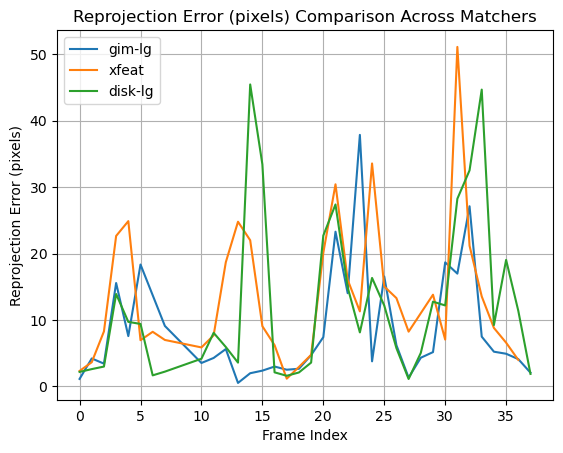

In [37]:

@timeout_decorator.timeout(200)
def analysis(undistort_first=True):
    tracks = {}  # key: track_id, value: list of (frame_idx, (x, y))
    track_id_counter = 0


    all_metrics = []

    for matcher_name in chosen_matchers:
        print(f"Matching with {matcher_name}")
        matcher = get_matcher([matcher_name], device=device, **ransac_kwargs)
        metrics_list = []

        i = 0
        while i < len(undistorted_frame_1fps):
            print(f"Frame {i} of {len(undistorted_frame_1fps)}")
            max_skip = 5
            success = False
            skip_used = 0
            


            for skip in range(1, max_skip + 1):
                if i + skip >= len(undistorted_frame_paths_1fps):
                    break

                img0, img1, depth_image_0, depth_image_1 = load_frame_pair(i, i + skip, matcher, undistort_first)
                result = matcher(img0, img1)
                num_inliers, H, mkpts0, mkpts1 = result['num_inliers'], result['H'], result['inlier_kpts0'], result['inlier_kpts1']
                
                pose = run_pose_estimation(mkpts0, mkpts1, K)
                
                if pose:
                    R, t = pose
                    success = True
                    skip_used = skip
                    T_est = np.eye(4)
                    T_est[:3, :3] = R
                    T_est[:3, 3] = t
                    tracks = update_tracks_from_pair(
                    tracks, mkpts0, mkpts1, frame0=i, frame1=i + skip_used
                    )
                    estimated_relative_poses.append(T_est)
                    break
                else:
                    print(f"[ERROR] Pose estimation failed for frame {i} with skip {skip}")

            if not success:
                print(f"[SKIP] No valid pose found for frame {i} within {max_skip} skips")
                i += 1
                continue

            T12_gt = np.eye(4)
            for k in range(i, i + skip_used):
                T12_gt = gt_relative_poses[k] @ T12_gt

            t_err, r_err, reproj_err = compute_metrics(
                R, t, T12_gt, mkpts0, mkpts1, depth_image_0, K,
                img0, img1, i, visualize=(i % 10 == 1)
            )

            metrics_list.append({
                'frame': i,
                'matcher': matcher_name,
                'num_inliers': num_inliers,
                'translation_error': t_err,
                'rotation_error': r_err,
                'skip': skip_used - 1,
                'reprojection_error': reproj_err
            })

            print(f"Translation error: {t_err:.2f}°, Rotation error: {r_err:.2f}°")

            if i == 5 or skip_used > 1:
                plot_matches(img0, img1, result)

            i += skip_used

        metrics_df = pd.DataFrame(metrics_list)
        all_metrics.append(metrics_df)
        plot_single_matcher_metrics(metrics_df, matcher_name)

    plot_combined_matcher_comparison(all_metrics)


# Run the analysis
try:
    analysis(undistort_first=True)
except timeout_decorator.TimeoutError:
    print("Function took too long and was terminated.")


In [38]:

# Plot the estimated trajectory
est_global_poses = compute_global_poses(estimated_relative_poses)
positions = extract_translation_vectors(est_global_poses)
plot_trajectory_plotly(positions)

In [39]:
fig = plot_gt_vs_relative_trajectory(
    gt_abs_poses=gt_abs_poses,
    gt_rel_poses=gt_relative_poses[0:],  
    title="GT Absolute vs Reconstructed Relative Trajectory"
)


In [42]:
print(tracks)

{}


### Old functions

In [ ]:
# chosen_matchers = ['gim-lg', 'disk-lg', 'xfeat']
# all_metrics = []
# matcher = get_matcher(['gim-lg'], device=device, **ransac_kwargs)  # Initial matcher
# image_size = 512

# @timeout_decorator.timeout(200)  # seconds
# def analysis(undistort_first=True):

#     # Pulls undistorted frame and depth map, extracted kpts and matches, attempts to estimate pose img0 to img1
#     # If fails, skips img1 and attempts to match to img2 and so on
#     # Calculates relative pose error and reprojection error (between gt pose warped kpts and estimated warped kpts)

#     for matcher_name in chosen_matchers:
#         print(f"Matching with {matcher_name}")
#         metrics_list = []
#         matcher = get_matcher([matcher_name], device=device, **ransac_kwargs)

#         i = 0
#         while i < len(undistorted_frame_1fps):
#             print(f"Frame {i} of {len(undistorted_frame_1fps)}")

#             def load_frame_pair(index0, index1):
#                 if undistort_first:
#                     img0 = matcher.load_image(undistorted_frame_paths_1fps[index0])
#                     img1 = matcher.load_image(undistorted_frame_paths_1fps[index1])
#                     depth_image_0 = undistorted_depth_1fps[index0]
#                     depth_image_1 = undistorted_depth_1fps[index1]
#                 else:
#                     img0 = matcher.load_image(frame_paths_1fps[index0], resize=image_size)
#                     img1 = matcher.load_image(frame_paths_1fps[index1], resize=image_size)
#                     depth_image_0 = depth_paths_1fps[index0]
#                     depth_image_1 = depth_paths_1fps[index1]
#                 return img0, img1, depth_image_0, depth_image_1

#             max_skip = 5
#             success = False
#             skip_used = 0
#             for skip in range(1, max_skip + 1):
#                 if i + skip >= len(undistorted_frame_paths_1fps):
#                     break

#                 img0, img1, depth_image_0, depth_image_1 = load_frame_pair(i, i + skip)
#                 result = matcher(img0, img1)
#                 num_inliers, H, mkpts0, mkpts1 = result['num_inliers'], result['H'], result['inlier_kpts0'], result['inlier_kpts1']

#                 try:
#                     T12_est = estimate_pose(mkpts0, mkpts1, K, K, thresh=0.5)
#                     if T12_est is None:
#                         raise ValueError("Pose estimation failed.")
#                     R, t, inliers, E = T12_est
#                     success = True
#                     skip_used = skip
#                     break
#                 except Exception as e:
#                     print(f"[ERROR] Pose estimation failed for frame {i} with skip {skip}: {e}")

#             if not success:
#                 print(f"[SKIP] No valid pose found for frame {i} within {max_skip} skips")
#                 i += 1
#                 continue

#             T12_gt = np.eye(4)
#             for k in range(i, i + skip_used):
#                 T12_gt = gt_relative_poses[k] @ T12_gt
#             T21_gt = np.linalg.inv(T12_gt)

#             T12_est_pose = np.eye(4)
#             T12_est_pose[:3, :3] = R
#             T12_est_pose[:3, 3] = t

#             visualize = (i % 10 == 1)
#             _, _, reproj_err = warp_kpts_with_depth_compare(
#                 gt_pose=T21_gt,
#                 est_pose=T12_est_pose,
#                 kpts0=mkpts0,
#                 depth_map=depth_image_0,
#                 K=K,
#                 img0=img0.permute(1, 2, 0).cpu().numpy(),
#                 img1=img1.permute(1, 2, 0).cpu().numpy(),
#                 kpts1=mkpts1,
#                 frame_idx=i,
#                 step=30,
#                 visualize=visualize
#             )

#             t_err, r_err = relative_pose_error(T21_gt, R, t, ignore_gt_t_thr=0.0)
#             metrics_list.append({
#                 'frame': i,
#                 'matcher': matcher_name,
#                 'num_inliers': num_inliers,
#                 'translation_error': t_err,
#                 'rotation_error': r_err,
#                 'skip': skip_used - 1,
#                 'reprojection_error': reproj_err
#             })

#             print(f"Translation error: {t_err:.2f} degrees")
#             print(f"Rotation error: {r_err:.2f} degrees")

#             if i == 5 or skip_used > 1:
#                 plot_matches(img0, img1, result)

#             i += skip_used

#         metrics_df = pd.DataFrame(metrics_list)
#         all_metrics.append(metrics_df)

#         clean_df = metrics_df.dropna()

#         plt.figure()
#         plt.plot(clean_df['frame'], clean_df['translation_error'], color='gray', linestyle='-', zorder=1)
#         scatter = plt.scatter(clean_df['frame'], clean_df['translation_error'], c=clean_df['skip'], cmap='viridis', marker='o', zorder=2)
#         plt.title(f"Translation Error - {matcher_name} (colored by skip)")
#         plt.xlabel('Frame Index')
#         plt.ylabel('Translation Error (degrees)')
#         cbar = plt.colorbar(scatter)
#         cbar.set_label('Number of Skips')
#         plt.grid(True)
#         plt.show()

#         plt.figure()
#         plt.plot(clean_df['frame'], clean_df['rotation_error'], color='gray', linestyle='-', zorder=1)
#         scatter = plt.scatter(clean_df['frame'], clean_df['rotation_error'], c=clean_df['skip'], cmap='viridis', marker='o', zorder=2)
#         plt.title(f"Rotation Error - {matcher_name} (colored by skip)")
#         plt.xlabel('Frame Index')
#         plt.ylabel('Rotation Error (degrees)')
#         cbar = plt.colorbar(scatter)
#         cbar.set_label('Number of Skips')
#         plt.grid(True)
#         plt.show()

#         plt.figure()
#         plt.plot(clean_df['frame'], clean_df['reprojection_error'], color='gray', linestyle='-', zorder=1)
#         scatter = plt.scatter(clean_df['frame'], clean_df['reprojection_error'], c=clean_df['skip'], cmap='viridis', marker='o', zorder=2)
#         plt.title(f"Reprojection Error - {matcher_name} (colored by skip)")
#         plt.xlabel('Frame Index')
#         plt.ylabel('Reprojection Error (pixels)')
#         cbar = plt.colorbar(scatter)
#         cbar.set_label('Number of Skips')
#         plt.grid(True)
#         plt.show()

#     # Plot combined matcher performance (ignoring skip)
#     all_df = pd.concat(all_metrics, ignore_index=True)
#     clean_all_df = all_df.dropna()

#     plt.figure()
#     for matcher_name in clean_all_df['matcher'].unique():
#         subset = clean_all_df[clean_all_df['matcher'] == matcher_name]
#         plt.plot(subset['frame'], subset['rotation_error'], label=matcher_name)
#     plt.title("Rotation Error Comparison Across Matchers")
#     plt.xlabel("Frame Index")
#     plt.ylabel("Rotation Error (degrees)")
#     plt.legend()
#     plt.grid(True)
#     plt.show()

#     plt.figure()
#     for matcher_name in clean_all_df['matcher'].unique():
#         subset = clean_all_df[clean_all_df['matcher'] == matcher_name]
#         plt.plot(subset['frame'], subset['translation_error'], label=matcher_name)
#     plt.title("Translation Error Comparison Across Matchers")
#     plt.xlabel("Frame Index")
#     plt.ylabel("Translation Error (degrees)")
#     plt.legend()
#     plt.grid(True)
#     plt.show()

#     plt.figure()
#     for matcher_name in clean_all_df['matcher'].unique():
#         subset = clean_all_df[clean_all_df['matcher'] == matcher_name]
#         plt.plot(subset['frame'], subset['skip'], label=matcher_name)
#     plt.title("Number of Skips per Frame by Matcher")
#     plt.xlabel("Frame Index")
#     plt.ylabel("Number of Skips")
#     plt.legend()
#     plt.grid(True)
#     plt.show()

#     plt.figure()
#     for matcher_name in clean_all_df['matcher'].unique():
#         subset = clean_all_df[clean_all_df['matcher'] == matcher_name]
#         plt.plot(subset['frame'], subset['reprojection_error'], label=matcher_name)
#     plt.title("Reprojection Error Comparison Across Matchers")
#     plt.xlabel("Frame Index")
#     plt.ylabel("Reprojection Error (pixels)")
#     plt.legend()
#     plt.grid(True)
#     plt.show()

# try:
#     analysis(undistort_first=True)
# except timeout_decorator.TimeoutError:
#     print("Function took too long and was terminated.")


: 

: 

: 

: 

In [ ]:
import matplotlib.pyplot as plt

def display_reprojection(img1 ,kpts0, kpts1, projected_kpts1, errors=None, max_points=100):
    """
    Overlay ground-truth and reprojected keypoints on img1.
    
    Args:
        img1 (np.ndarray): Image where keypoints are reprojected.
        kpts1 (np.ndarray): Ground-truth keypoints in img1.
        projected_kpts1 (np.ndarray): Reprojected keypoints.
        errors (np.ndarray): Optional reprojection errors.
        max_points (int): Max number of keypoints to plot for readability.
    """
    plt.figure(figsize=(10, 8))
    plt.imshow(img1, cmap='gray')
    
    n = min(len(kpts1), max_points)
    
    # Plot ground truth
    plt.scatter(kpts1[:n, 0], kpts1[:n, 1], c='lime', label='GT Keypoints', s=40, marker='x')
    
    # Plot reprojected
    plt.scatter(projected_kpts1[:n, 0], projected_kpts1[:n, 1], c='red', label='Reprojected', s=40, marker='o', facecolors='none')

    # Plot reprojected
    plt.scatter(kpts0[:n, 0], kpts0[:n, 1], c='pink', label='mkpts0', s=40, marker='o', facecolors='none')

    # Optionally draw lines between matched points
    for i in range(n):
        pt1 = kpts1[i]
        pt2 = projected_kpts1[i]
        plt.plot([pt1[0], pt2[0]], [pt1[1], pt2[1]], 'y-', linewidth=0.8)

    if errors is not None:
        mean_err = np.mean(errors[:n])
        plt.title(f"Reprojection (mean error: {mean_err:.2f} px)")
    else:
        plt.title("Reprojection comparison")

    plt.legend()
    plt.axis('off')
    plt.tight_layout()
    plt.show()


: 

: 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def backproject_and_reproject(kpts0, depth0, K):
    """
    Backprojects keypoints into 3D and reprojects them back into img0.
    Used to check consistency of intrinsics and depth.
    
    Args:
        kpts0 (np.ndarray): Nx2 array of keypoints in image0.
        depth0 (np.ndarray): HxW depth map.
        K (np.ndarray): 3x3 camera intrinsics.

    Returns:
        kpts0_reproj (np.ndarray): Nx2 array of reprojected keypoints.
        errors (np.ndarray): Nx1 reprojection error (pixels).
    """
    fx, fy = K[0, 0], K[1, 1]
    cx, cy = K[0, 2], K[1, 2]

    # Extract depths at keypoint locations
    u, v = kpts0[:, 0].astype(int), kpts0[:, 1].astype(int)
    z = depth0[v, u]

    # Backproject to 3D
    x = (kpts0[:, 0] - cx) * z / fx
    y = (kpts0[:, 1] - cy) * z / fy

    # Reproject back into img0
    u_reproj = (x * fx / z) + cx
    v_reproj = (y * fy / z) + cy

    kpts0_reproj = np.stack([u_reproj, v_reproj], axis=1)
    errors = np.linalg.norm(kpts0_reproj - kpts0, axis=1)

    return kpts0_reproj, errors


: 

: 

In [ ]:

import numpy as np

def debug_single_keypoint(kpt0, kpt1, depth0, K, T12):
    """
    Walk through the full pipeline for a single keypoint:
    - Backproject
    - Transform
    - Project into img1
    - Compare with actual kpt1

    Args:
        kpt0 (array-like): [u0, v0] in img0
        kpt1 (array-like): [u1, v1] in img1
        depth0 (np.ndarray): depth map from img0
        K (np.ndarray): camera intrinsics
        T12 (np.ndarray): 4x4 transformation from cam0 to cam1
    """
    fx, fy = K[0, 0], K[1, 1]
    cx, cy = K[0, 2], K[1, 2]

    u0, v0 = int(kpt0[0]), int(kpt0[1])
    z = depth0[v0, u0]

    print(f"🔹 Original keypoint in img0: {kpt0}")
    print(f"🔹 Corresponding keypoint in img1 (GT): {kpt1}")
    print(f"🔹 Depth at (u0, v0): {z:.4f}")

    # Backproject to 3D (camera 0 frame)
    x = (kpt0[0] - cx) * z / fx
    y = (kpt0[1] - cy) * z / fy
    pt3D_cam0 = np.array([x, y, z, 1.0])

    print(f"🔹 Backprojected 3D point in cam0 frame: {pt3D_cam0[:3]}")

    # Transform to cam1 frame
    pt3D_cam1 = T12 @ pt3D_cam0
    print(f"🔹 Transformed 3D point in cam1 frame: {pt3D_cam1[:3]}")

    # Project to 2D in cam1
    x1, y1, z1 = pt3D_cam1[:3]
    u1_proj = (x1 * fx / z1) + cx
    v1_proj = (y1 * fy / z1) + cy
    kpt1_proj = np.array([u1_proj, v1_proj])

    print(f"🔹 Projected keypoint in img1: {kpt1_proj}")
    print(f"🔹 Ground truth keypoint in img1: {kpt1}")
    print(f"🔹 Reprojection error: {np.linalg.norm(kpt1_proj - kpt1):.2f} pixels")


: 

: 

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot_3d_overlay(kpts0, depth0, K, T12):
    """
    Plot 3D points from cam0 frame and their transformed version in cam1 frame in one 3D plot.
    
    Args:
        kpts0 (np.ndarray): Nx2 keypoints in img0.
        depth0 (np.ndarray): HxW depth map of img0.
        K (np.ndarray): 3x3 intrinsic matrix.
        T12 (np.ndarray): 4x4 transform from cam0 to cam1.
    """
    fx, fy = K[0, 0], K[1, 1]
    cx, cy = K[0, 2], K[1, 2]
    
    # Get depth for each keypoint
    z = depth0[kpts0[:, 1].astype(int), kpts0[:, 0].astype(int)]
    x = (kpts0[:, 0] - cx) * z / fx
    y = (kpts0[:, 1] - cy) * z / fy

    # Construct 3D homogeneous coordinates
    pts_cam0_hom = np.stack([x, y, z, np.ones_like(z)], axis=1)  # Nx4

    # Transform to cam1 frame
    pts_cam1 = (T12 @ pts_cam0_hom.T).T[:, :3]

    # Original 3D points (in cam0 frame)
    pts_cam0 = pts_cam0_hom[:, :3]

    # Plot
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    ax.scatter(pts_cam0[:, 0], pts_cam0[:, 1], pts_cam0[:, 2], c='blue', label='Cam0 Points', s=8)
    ax.scatter(pts_cam1[:, 0], pts_cam1[:, 1], pts_cam1[:, 2], c='green', label='Transformed to Cam1', s=8)

    # Optionally draw lines between original and transformed points
    for i in range(len(pts_cam0)):
        ax.plot(
            [pts_cam0[i, 0], pts_cam1[i, 0]],
            [pts_cam0[i, 1], pts_cam1[i, 1]],
            [pts_cam0[i, 2], pts_cam1[i, 2]],
            color='gray', linewidth=0.5, alpha=0.5
        )

    ax.set_title("3D Points: Cam0 Frame and Transformed to Cam1")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.legend()
    ax.view_init(elev=20, azim=135)
    plt.tight_layout()
    plt.show()


: 

: 

In [ ]:


def project_and_compare(kpts0, kpts1, depth0, K, T12):
    """
    Projects kpts0 from img0 into 3D, transforms them by T12, reprojects into img1,
    and compares them to kpts1.

    Args:
        kpts0 (np.ndarray): Nx2 array of keypoints in img0.
        kpts1 (np.ndarray): Nx2 array of keypoints in img1.
        depth0 (np.ndarray): HxW depth map of img0.
        K (np.ndarray): 3x3 camera intrinsic matrix.
        T12 (np.ndarray): 4x4 transformation matrix from cam0 to cam1.

    Returns:
        projected_kpts1 (np.ndarray): Nx2 reprojected keypoints in img1.
        errors (np.ndarray): Nx1 Euclidean distances to kpts1.
    """
    # Unproject kpts0 to 3D using depth and intrinsics
    fx, fy = K[0, 0], K[1, 1]
    cx, cy = K[0, 2], K[1, 2]
    
    kpts0_h = np.hstack([kpts0, np.ones((kpts0.shape[0], 1))])  # Nx3

    # Get depth at each keypoint location
    z = depth0[kpts0[:, 1].astype(int), kpts0[:, 0].astype(int)]  # Nx1
    x = (kpts0[:, 0] - cx) * z / fx
    y = (kpts0[:, 1] - cy) * z / fy

    pts3D = np.stack([x, y, z, np.ones_like(z)], axis=1)  # Nx4

    # Transform to camera 1
    pts3D_cam1 = (T12 @ pts3D.T).T  # Nx4
    pts3D_cam1 = pts3D_cam1[:, :3]

    # Project into img1
    x1 = pts3D_cam1[:, 0]
    y1 = pts3D_cam1[:, 1]
    z1 = pts3D_cam1[:, 2]

    u1 = (x1 * fx / z1) + cx
    v1 = (y1 * fy / z1) + cy

    projected_kpts1 = np.stack([u1, v1], axis=1)

    # Compute error (Euclidean distance)
    errors = np.linalg.norm(projected_kpts1 - kpts1, axis=1)
    
    return projected_kpts1, errors


: 

: 

In [ ]:
# def project_points(points, T_cam_to_world, K):
#     N = points.shape[0]
#     print("POINTS 0: ", points[0:5])
#     # Convert (N, 3) -> (N, 4) homogeneous coordinates
#     points_homogeneous = np.hstack((points, np.ones((N, 1))))  # shape (N, 4)
#     print(np.shape(points_homogeneous))
#     # Transform to world frame using T_cam_to_world
#     points_world = (T_cam_to_world @ points_homogeneous.T).T  # shape (N, 4)

#     # Drop the homogeneous coordinate after transformation
#     points_world = points_world[:, :3]  # shape (N, 3)

#     # Now project points into image space using intrinsic matrix K
#     points_proj = (K @ points_world.T).T  # shape (N, 3)

#     # Normalize the projected points by dividing by z (the 3rd coordinate)
#     points_proj /= points_proj[:, 2][:, np.newaxis]

#     return points_proj[:, :2]  # Return the 2D image coordinates (x, y)


: 

: 

In [ ]:
# import cv2
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# from google.colab.patches import cv2_imshow  # Import cv2_imshow
# import os


# Configure pandas to display full matrices without truncation
pd.set_option('display.max_rows', None)        # Show all rows
pd.set_option('display.max_columns', None)     # Show all columns
pd.set_option('display.width', None)           # Auto-detect display width
pd.set_option('display.max_colwidth', None)    # Show full content of each cell
pd.set_option('display.precision', 10)         # Show 10 decimal places for floating point numbers
np.set_printoptions(precision=10, suppress=True, threshold=np.inf)  # Configure NumPy printing


chosen_matchers = ['disk-lg','xfeat']
matcher = get_matcher(['gim-lg'], device=device, **ransac_kwargs) # Initialize the matcher
image_size = 512

# Load image pairs and match keypoints
for matcher_name in chosen_matchers:
  print(f"Matching with {matcher_name} \n undistorted images, sierras camera to world, no alignment?")
  metrics_list = []
  matcher = get_matcher([matcher_name], device=device, **ransac_kwargs)

  for i in range(0, 3):
      print(f"Frame {i} of {len(frame_paths_1fps)}")

      img0 = matcher.load_image(frame_paths_1fps[i], resize=image_size)
      img1 = matcher.load_image(frame_paths_1fps[i + 1], resize=image_size)

      # Perform feature matching
      result = matcher(img0, img1)

      num_inliers, H, mkpts0, mkpts1 = result['num_inliers'], result['H'], result['inlier_kpts0'], result['inlier_kpts1']

      T12_gt = gt_relative_poses[i]
      print(T12_gt)
      # Estimate relative pose from matches
      T12_est = estimate_pose(mkpts0, mkpts1, K, K, thresh=0.5)  # where K is the intrinsic matrix

      # Pull out the r and t for the estimate
      R, t, inliers, E = T12_est
      # Estimate relative pose from matches
      T12_est_pose = np.eye(4)
      T12_est_pose[:3, :3] = R
      T12_est_pose[:3, 3] = t



      # print(T21_gt)
      t_err, r_err = relative_pose_error(T12_gt, R, t, ignore_gt_t_thr=0.0)

      print(f"Translation error: {t_err} degrees")
      print(f"Rotation error: {r_err} degrees")



# -----------_WARPING-------------------------
      # t_gt = T21_gt[:3,3]

      # t_scaled = t   # Scaling down the translation
      # img0_warped = warp_image(img0, K, R, t_scaled)

      # # img0_warped = warp_image(img0, K, R_gt, t_gt)

      # # Convert Torch tensors to NumPy arrays (if necessary)
      # if isinstance(img0, torch.Tensor):
      #     img0 = img0.cpu().numpy()
      #     img0 = np.transpose(img0, (1, 2, 0))  # Convert from (C, H, W) to (H, W, C)

      # if isinstance(img1, torch.Tensor):
      #     img1 = img1.cpu().numpy()
      #     img1 = np.transpose(img1, (1, 2, 0))  # Convert from (C, H, W) to (H, W, C)

      # if isinstance(img0_warped, torch.Tensor):
      #     img0_warped = img0_warped.cpu().numpy()
      #     img0_warped = np.transpose(img0_warped, (1, 2, 0))  # Convert from (C, H, W) to (H, W, C)

      # # Convert images to uint8 for OpenCV
      # img0 = (img0 * 255).astype(np.uint8) if img0.dtype != np.uint8 else img0
      # img1 = (img1 * 255).astype(np.uint8) if img1.dtype != np.uint8 else img1
      # img0_warped = (img0_warped * 255).astype(np.uint8) if img0_warped.dtype != np.uint8 else img0_warped

      # # Stack the images horizontally
      # img_combined = np.hstack((img0, img1, img0_warped))

      # # Show the combined image (side by side)
      # cv2_imshow(img_combined)
#---------------------------------
      # result['all_kpts0'] = mkpts0
      # plot_kpts(img0, result)
      # result['all_kpts0'] = mkpts1
      # plot_kpts(img1, result)

      # T_test = np.array([
      #     [1,  0,  0,  0],  # x-axis stays the same
      #     [0, 1,  0,  0],  # y-axis flips
      #     [0,  0, 1,  1],  # z-axis flips
      #     [0,  0,  0,  1]   # homogeneous component
      # ])
      # result['all_kpts0'] = warp_kpts(mkpts0, K, T_test)
      # T12_gt = invert_transform(T21_gt)
      # T21_scaled = scale_translation(T21_gt, 0.001)
      # result['all_kpts0'] = warp_kpts(mkpts0, K, T21_est_pose)
      # plot_kpts(img1, result)

      # result['inlier_kpts0'] = mkpts0[:]
      # result['inlier_kpts1'] = mkpts1[:10]
      # result['matched_kpts0'] = []
      # result['matched_kpts1'] = []


      result['all_kpts0'] = warp_kpts(mkpts0, K, T12_est_pose)
      # plot_kpts(img1, result)

      visualize_projection_error(True,img1.permute(1, 2, 0).cpu().numpy(), mkpts1, warp_kpts(mkpts0, K, T12_gt), gt_matches=None, scale_factor=1.0, save_path=None)
      visualize_projection_error(False,img1.permute(1, 2, 0).cpu().numpy(), mkpts1, warp_kpts(mkpts0, K, T12_est_pose), gt_matches=None, scale_factor=1.0, save_path=None)

      # T21_est_scaled = scale_translation(T21_est_pose, 0.001)
      # result['all_kpts0'] = warp_kpts(mkpts0, K, T21_est_scaled)
      # plot_kpts(img1, result)
      plot_matches(img0, img1, result)




  break

  # Convert the list of metrics to a DataFrame
  metrics_df = pd.DataFrame(metrics_list)

  # # Save the DataFrame to a CSV file in the results directory, using the video name
  # results_file_path = os.path.join(results_dir, f'{video_name}_metrics_{matcher_name}.csv')
  # metrics_df.to_csv(results_file_path, index=False)


  # # Save the DataFrame to a CSV file
  # metrics_df.to_csv('video_metrics.csv', index=False)

  # Display the DataFrame
  display(metrics_df)
  break
  print("------------------------------")

: 

: 